In [ ]:
import cv2
import os, shutil
import random
import numpy as np
from sklearn.preprocessing import LabelEncoder
from matplotlib import pyplot as plt
import tensorflow as tf
import keras
import keras.backend as K
from keras.utils import np_utils
from tensorflow.keras import models

import tensorflow as tf
tf.test.is_gpu_available()
#tf.test.is_built_with_cuda()

from tensorflow.python.client import device_lib
from tensorflow.keras.models import Model
from tensorflow.keras import layers
import pandas as pd
from tensorflow.keras.utils import to_categorical
import cv2
import os
from os import listdir
import cv2
import numpy as np
import pickle
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from keras.applications.vgg16 import VGG16
from  keras.applications.resnet_v2 import ResNet50V2
from keras.layers import Input, Flatten, Dense, Dropout
from keras.models import Model
from keras.callbacks import ModelCheckpoint
import matplotlib.pyplot as plt
import random
from keras.preprocessing.image import ImageDataGenerator
from google.colab.patches import cv2_imshow
from keras.optimizers import adam_v2
import tensorflow as tf
from tensorflow import keras

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

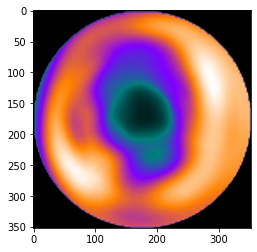

In [ ]:
imgRootDir = "./drive/MyDrive/Explainable/New_RawAC/"
imgDirPaths = [path for path in os.listdir(imgRootDir)]

#Lấy ra đường dẫn đến ảnh
#imgPaths = list(map(lambda path : os.path.join(imgRootDir, path, "stress.jpg"), imgDirPaths))

#Đọc ảnh
for imgDirPath in imgDirPaths:
  # read input
  img = cv2.imread(os.path.join(imgRootDir, imgDirPath, 'stress.jpg'))

  # convert to gray
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

  # threshold and invert
  #thresh = cv2.threshold(gray, 155, 255, cv2.THRESH_BINARY)[1]
  thresh = cv2.threshold(gray, 160, 255, cv2.THRESH_BINARY)[1]

  # apply morphology close
  kernel = np.ones((3, 3), np.uint8)
  thresh = cv2.morphologyEx(thresh, cv2.MORPH_DILATE, kernel)

  # get contours and filter to keep only small regions
  mask = np.zeros_like(gray, dtype=np.uint8)
  cntrs = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  cntrs = cntrs[0] if len(cntrs) == 2 else cntrs[1]
  for c in cntrs:
      area = cv2.contourArea(c)
      if area < 1000:
          cv2.drawContours(mask, [c], 0, 255, -1)

  # do inpainting
  result = cv2.inpaint(img, mask, 3, cv2.INPAINT_TELEA)
  img = result
  # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  #Crop ảnh
  #Crop ảnh
  croped_img = img[51:403,102:454]
  #plt.imshow(croped_img)
  radius = 176
  cx, cy = radius, radius # The center of circle
  x,y = np.ogrid[-radius: radius, -radius: radius]
  index = x**2 + y**2 > radius**2
  croped_img[cy-radius:cy+radius, cx-radius:cx+radius][index] = 0
  #plt.imshow(croped_img)

  croped_img2=cv2.cvtColor(croped_img, cv2.COLOR_BGR2RGB)
  plt.imshow(croped_img2)
  cv2.imwrite(os.path.join(imgRootDir, imgDirPath, 'croped_circle.jpg'), cv2.cvtColor(croped_img2, cv2.COLOR_BGR2RGB))

#Lấy đường dẫn ảnh sau khi đã crop
imgPaths = list(map(lambda path : os.path.join(imgRootDir, path, 'croped_circle.jpg'), imgDirPaths))
#print(imgPaths)

In [ ]:
#Hàm lấy dòng đầu tiên của file txt đầu tiên
def getText(dirName):
  #Chỉ lấy file .txt tạo thành 1 list mới
  #join ghép imgRootDir và dirName thành 1 đường dẫn mới
  fileName = list(filter(lambda textPath : textPath[-4:] == '.txt', os.listdir(os.path.join(imgRootDir, dirName))))[0] 
  #Mở file txt
  with open(os.path.join(imgRootDir, dirName, fileName), 'r') as fd:
    firstLine = fd.readline() #Lấy dòng đầu tiên
  
  return firstLine.rstrip() # rstrip bỏ ký tự cuối cùng là \n

#Chuyển đổi list thư mục trong Raw_sample thành 1 list mới là các labels
labels = list(map(getText, imgDirPaths)) 
print(labels[0:5])

#Chuyển labels thành số
le = LabelEncoder()
labels = le.fit_transform(labels)
#labels = to_categorical(labels)
print(labels[0:5])

['khong-co-benh', 'co-benh', 'khong-co-benh', 'khong-co-benh', 'co-benh']
[1 0 1 1 0]


In [ ]:
import numpy as np
from keras.preprocessing.image import img_to_array
from keras.applications import imagenet_utils
from keras.preprocessing.image import load_img

#Load ảnh và resize lại đứng kích thước mà VGG16 cần
list_image = []
list_image_org = []
for (j, imagePath) in enumerate(imgPaths):
  image = load_img(imagePath, target_size=(224, 224))
  list_image_org.append(image)#Dùng để hiển thị cuối
  image = img_to_array(image) #Chuyển ảnh về ma trận  
  image = np.expand_dims(image, 0) #Bao quanh bên ngoài ma trận bằng số 0   
  #list_image_org.append(image)
  # Scale inputs to [-1, +1]
  # image =tf.keras.applications.resnet_v2.preprocess_input(image)
    
  image = imagenet_utils.preprocess_input(image) #Làm đầy ảnh để có được kích thước như yêu cầu
  #image = tf.keras.applications.inception_v3.preprocess_input(image)
  #image = tf.keras.applications.vgg16.preprocess_input(image)
  #image = tf.keras.applications.resnet_v2.preprocess_input(image)

  list_image.append(image)

list_image = np.vstack(list_image) #Xếp các mảng theo trình tự theo chiều dọc
#list_image_org = np.vstack(list_image_org) #Xếp các mảng theo trình tự theo chiều dọc

print(list_image.shape)
print(list_image[0][0][0])

(218, 224, 224, 3)
[-103.939 -116.779 -123.68 ]


In [ ]:
from sklearn.model_selection import train_test_split

# Chia traing set, test set tỉ lệ 80-20
X_train, X_test, y_train, y_test = train_test_split(list_image, labels, test_size=0.2, random_state=42)
X_train2, X_test2, y_train2, y_test2 = train_test_split(list_image_org, labels, test_size=0.2, random_state=42)

In [ ]:
X_train = X_train.astype('float')/255.0
X_test  = X_test.astype('float')/255.0

**TRAIN**

In [ ]:
def get_model():
    model_vgg16_conv = VGG16(weights='imagenet', include_top=False)

    # Dong bang cac layer
    for layer in model_vgg16_conv.layers:
        layer.trainable = False

    # Tao model
    input = Input(shape=(224, 224, 3), name='image_input')
    output_vgg16_conv = model_vgg16_conv(input)
    # Them cac layer FC va Dropout
    x = keras.layers.GlobalAveragePooling2D()(output_vgg16_conv)
    x = Dense(256, activation='relu')(x)
    x = Dropout(0.2)(x)
    x = Dense(2, activation='softmax', name='predictions')(x)
    optim_1 = adam_v2.Adam(learning_rate= 0.001)
    # Compile
    my_model = Model(inputs=input, outputs=x)
    my_model.compile(loss='sparse_categorical_crossentropy', optimizer=optim_1, metrics=['accuracy'])

    return my_model

In [ ]:
vggmodel = get_model()

94683136/94668760 [==============================] - 1s 0us/step


In [ ]:
vggmodel.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 resnet50v2 (Functional)     (None, None, None, 2048)  23564800  
                                                                 
 global_average_pooling2d_1   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_1 (Dense)             (None, 256)               524544    
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 predictions (Dense)         (None, 2)                 514       
                                                           

In [ ]:
filepath="./drive/MyDrive/Explainable/best_weight.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]



vgghist=vggmodel.fit(X_train, y_train,
                               epochs=50,
                               validation_data=(X_test,y_test),
                               callbacks=callbacks_list)


In [ ]:
vggmodel.built = True
vggmodel.load_weights(filepath)

In [ ]:
vggmodel.save("./drive/MyDrive/Explainable/best_model.h5")

In [ ]:
vgghist.history.keys()

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

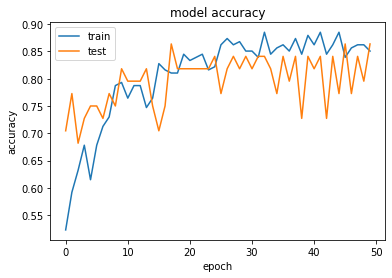

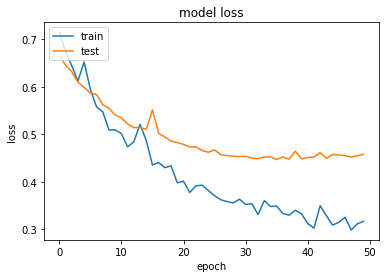

In [ ]:
plt.plot(vgghist.history['accuracy'])
plt.plot(vgghist.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(vgghist.history['loss'])
plt.plot(vgghist.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
# Load mô hình và bộ trọng số
best_model = keras.models.load_model(filepath='./drive/MyDrive/Explainable/models/bestmodel.h5')
best_model.load_weights('./drive/MyDrive/Explainable/models/weights.hdf5')

In [ ]:
best_model.evaluate(X_test, y_test)

2/2 [==============================] - 14s 745ms/step - loss: 0.2505 - acc: 0.9545


[0.25051021575927734, 0.9545454382896423]

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score, roc_curve, auc

In [ ]:
predictions_NN_prob = best_model.predict(X_test)
predictions_NN_prob = predictions_NN_prob[:,0]
predictions_NN_01 = np.where(predictions_NN_prob > 0.5, 1, 0)
#Print accuracy
acc_NN = accuracy_score(y_test, predictions_NN_01)
print('Overall accuracy of Neural Network model:', acc_NN)
#Print Area Under Curve
false_positive_rate, recall, thresholds = roc_curve(y_test, predictions_NN_prob)
print(recall)

Overall accuracy of Neural Network model: 0.045454545454545456
[0.         0.         0.         0.31818182 0.31818182 0.86363636
 0.86363636 1.        ]


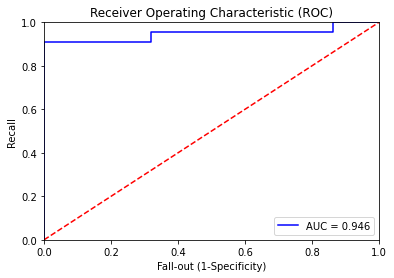

In [ ]:
roc_auc = auc(recall,false_positive_rate)
plt.figure()
plt.title('Receiver Operating Characteristic (ROC)')
plt.plot(recall,false_positive_rate, 'b', label = 'AUC = %0.3f' %roc_auc)
plt.legend(loc='lower right')
plt.plot([0,1], [0,1], 'r--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.0])
plt.ylabel('Recall')
plt.xlabel('Fall-out (1-Specificity)')
plt.show()

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix

y_hat = best_model.predict(X_test)
print(y_hat.shape)
y_pred = np.argmax(y_hat, axis=1)
print(y_pred.shape)
# print(y_test)
# y_test_label = np.argmax(y_test, axis=-1)
y_test_label = y_test
print(y_test_label.shape)

# Tính accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test_label, y_pred)
print('Accuracy: %f' % accuracy)
# Tính precision tp / (tp + fp)
precision = precision_score(y_test_label, y_pred, average='macro')
print('Precision: %f' % precision)
# Tính recall: tp / (tp + fn)
recall = recall_score(y_test_label, y_pred, average='macro')
print('Recall: %f' % recall)
# Tính f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test_label, y_pred, average='macro')
print('F1 score: %f' % f1)

tn, fp, fn, tp = confusion_matrix(y_test_label, y_pred).ravel()
tnr = tn/(tn + fp)
print("Specificity: %f" % tnr)

(44, 2)
(44,)
(44,)
Accuracy: 0.954545
Precision: 0.958333
Recall: 0.954545
F1 score: 0.954451
Specificity: 0.909091


**Predicton**

In [ ]:
label = ['co-benh','khong-benh']

In [ ]:
def predict(image):
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  image_copy  = image
  image = image.astype('float')/255.0
  image = np.expand_dims(image,axis=0)
  preds = best_model.predict(image)
  return image_copy,preds

[[0.02398971 0.97601026]]
1
khong-benh


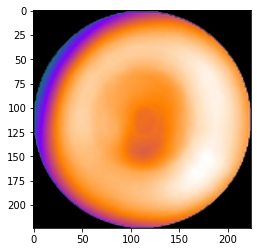

In [ ]:
image = cv2.imread(imgPaths[2])
image = cv2.resize(image,(224,224))
image, preds = predict(image)
print(preds)
idx = np.argmax(preds)
print(idx)
print(label[idx])
plt.imshow(image)

#XAI

This picture is:  co-benh [0.03381833 0.9661817 ]
0.9661817


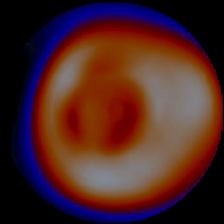

This picture is:  khong-co-benh [9.9945337e-01 5.4658373e-04]
0.99945337


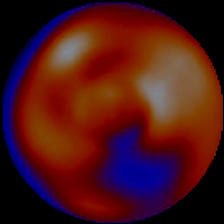

This picture is:  co-benh [0.00512654 0.99487346]
0.99487346


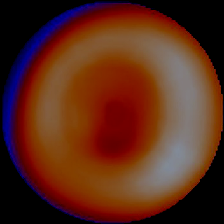

This picture is:  co-benh [0.0169065 0.9830935]
0.9830935


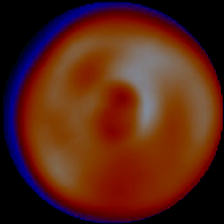

This picture is:  khong-co-benh [0.9963806  0.00361942]
0.9963806


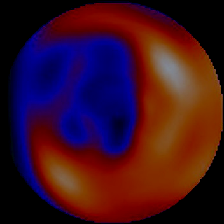

In [ ]:
for i in range(5):
  image = cv2.resize(list_image[i], dsize=(224, 224))
  image = image.astype('float')*1./255
  image = np.expand_dims(image, axis=0)
  predict = best_model.predict(image)
  print("This picture is: ", labels[np.argmax(predict[0])], (predict[0]))
  print(np.max(predict[0],axis=0))
  cv2_imshow(list_image[i])

In [ ]:
!pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 275 kB 7.1 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=6211e4809fed03a56d5cab39087ae8bb251a90d8f01e60a20e76e3ddc42f8ecf
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime


In [ ]:
import matplotlib.image as mpimg

In [ ]:
import matplotlib.image as mpimg
from lime import lime_image
from skimage.segmentation import mark_boundaries

In [ ]:
explainer = lime_image.LimeImageExplainer()

In [ ]:
def predict(path):
  image = cv2.imread(path)
  image = cv2.resize(image,(224,224))
  image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
  image = np.expand_dims(image, axis=0)
  image = image.astype('float')/255.0
  return best_model.predict(image)

In [ ]:
def explain(path):
  preds = predict(path)
  image = cv2.imread(path)
  image = cv2.resize(image,(224,224))
  image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
  image = image.astype('float')/255.0


  explainer = lime_image.LimeImageExplainer()
  explanation = explainer.explain_instance(image, best_model.predict, top_labels=2,  num_samples=2000)


  index_0 = explanation.top_labels[0]
  index_1 = explanation.top_labels[1]


  fig = plt.figure(figsize=(25, 20))
  fig.add_subplot(131)

  temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=True)
  plt.imshow(mark_boundaries(image, mask))


  plt.title(labels[index_0]+' prob: '+str(preds[0][index_0]))
  plt.axis('off')

  fig.add_subplot(133)


  temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], negative_only=True, positive_only=False, num_features=5, hide_rest=True)
  plt.imshow(mark_boundaries(image, mask))


  plt.title(labels[index_1]+ ' prob: '+str(preds[0][index_1]))
  plt.axis('off')



  fig.add_subplot(132)
    #Select the same class explained on the figures above.
  ind =  explanation.top_labels[0]

  dict_heatmap = dict(explanation.local_exp[ind])
  heatmap = np.vectorize(dict_heatmap.get)(explanation.segments) 
  plt.title('heatmap')
  plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max(),alpha=1.0)
  plt.imshow(image,alpha = 0.5)


  plt.axis('off')





  plt.show()

  0%|          | 0/2000 [00:00<?, ?it/s]

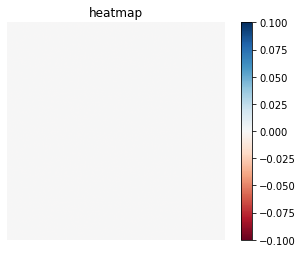

In [ ]:
image = cv2.imread(imgPaths[2])
image = cv2.resize(image,(224,224))
image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
image = image.astype('float')
explainer = lime_image.LimeImageExplainer()
explanation = explainer.explain_instance(image, best_model.predict, top_labels=2,  num_samples=2000)
  #Select the same class explained on the figures above.
ind =  explanation.top_labels[0]
dict_heatmap = dict(explanation.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation.segments) 
plt.title('heatmap')
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max(),alpha=1.0)
plt.axis('off')
plt.colorbar()
plt.show()

list_acc = []

for i in np.arange(-heatmap.max(),heatmap.max(),0.001):
  temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=20, hide_rest=False,min_weight=i)
  plt.imshow(temp)
  plt.show()
  preds = predict(temp/255.0)
  list_acc.append(preds[0][ind])

In [ ]:
image = cv2.imread(imgPaths[1])
image = cv2.resize(image,(224,224))
image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
image = image.astype('float')
explainer = lime_image.LimeImageExplainer()
explanation = explainer.explain_instance(image, best_model.predict, top_labels=2,  num_samples=1000)


  0%|          | 0/2000 [00:00<?, ?it/s]

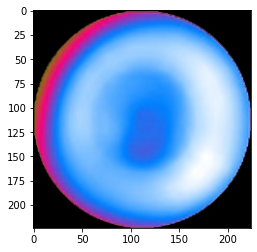

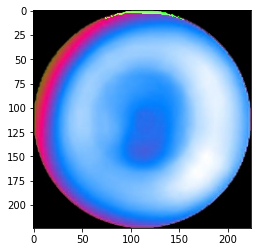

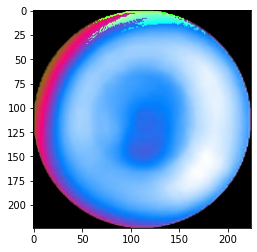

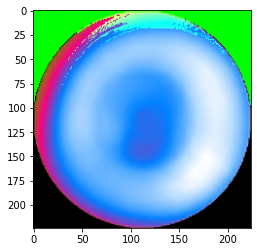

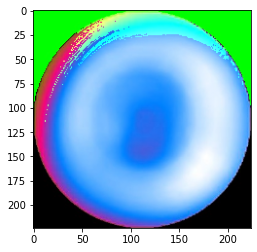

...

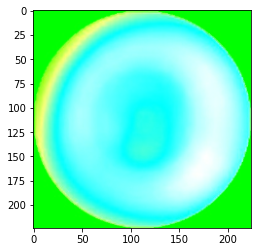

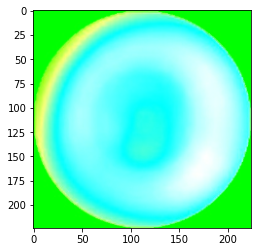

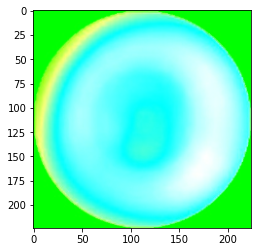

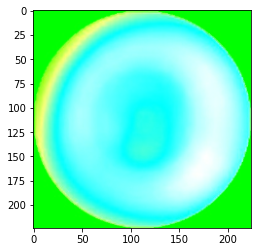

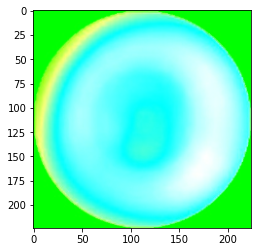

In [ ]:
image = cv2.imread(imgPaths[2])
image = cv2.resize(image,(224,224))
image = image.astype('float')
explainer = lime_image.LimeImageExplainer()
explanation = explainer.explain_instance(image, best_model.predict, top_labels=2,  num_samples=2000)
  #Select the same class explained on the figures above.
ind =  explanation.top_labels[0]
list_acc = []
for i in np.arange(0,300,10):
  temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=i, hide_rest=False)
  plt.imshow(temp/255.0)
  plt.show()
  # preds = predict(temp)
  # list_acc.append(preds[0][ind])

  0%|          | 0/2000 [00:00<?, ?it/s]

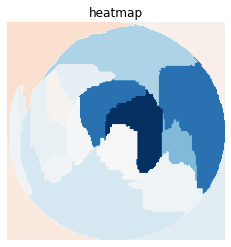

In [ ]:
image = cv2.imread(imgPaths[2])
image = cv2.resize(image,(224,224))
image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
image = image.astype('float')/255.0
explainer = lime_image.LimeImageExplainer()
explanation = explainer.explain_instance(image, best_model.predict, top_labels=2,  num_samples=2000)
  #Select the same class explained on the figures above.
ind =  explanation.top_labels[0]
dict_heatmap = dict(explanation.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation.segments) 
plt.title('heatmap')
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max(),alpha=1.0)
plt.axis('off')
plt.show()

# list_acc = []

# for i in range(20,-1,-1):
#   temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=i, hide_rest=False)
#   plt.imshow(temp)
#   plt.show()
#   preds = predict(temp)
#   list_acc.append(preds[0][ind])

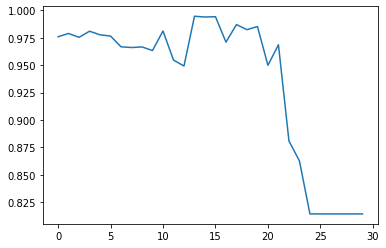

In [ ]:
plt.plot(list_acc)

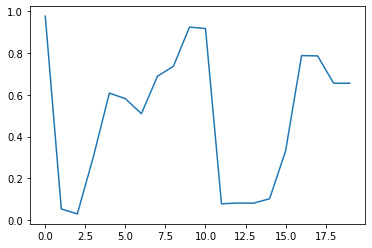

In [ ]:
plt.plot(list_acc)

In [ ]:
imagetmp = cv2.imread(imgPaths[0])
imagetmp = cv2.resize(imagetmp,(224,224))
imagetmp = np.expand_dims(imagetmp, axis=0)
imagetmp = imagetmp.astype('float')/255.0
pred =  best_model.predict(imagetmp)

In [ ]:
pred[0][0]

0.09795858

In [ ]:
def predict(image):
  image = np.expand_dims(temp, axis=0)
  image = image.astype('float')/255.0
  preds =  best_model.predict(image)
  print(preds)
  return preds

In [ ]:
preds

array([[0.4107493 , 0.58925074]], dtype=float32)

  0%|          | 0/2000 [00:00<?, ?it/s]

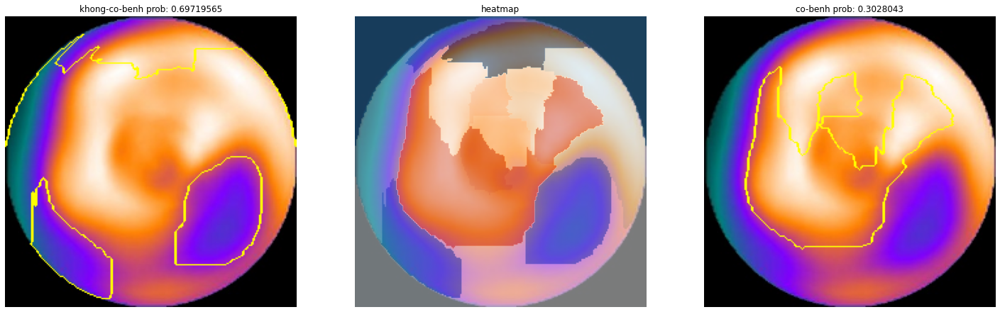

  0%|          | 0/2000 [00:00<?, ?it/s]

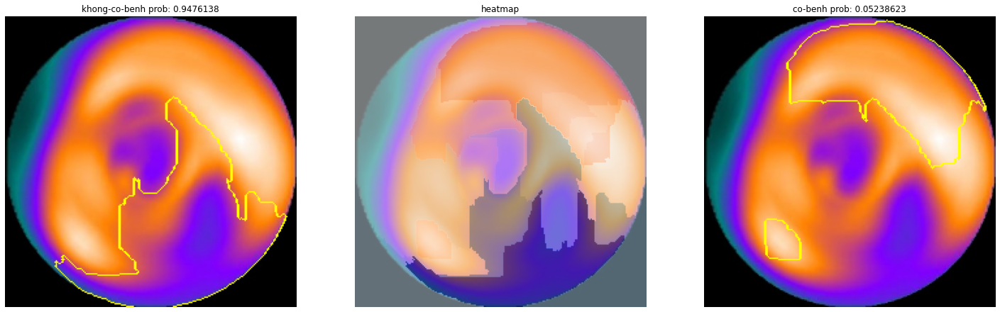

  0%|          | 0/2000 [00:00<?, ?it/s]

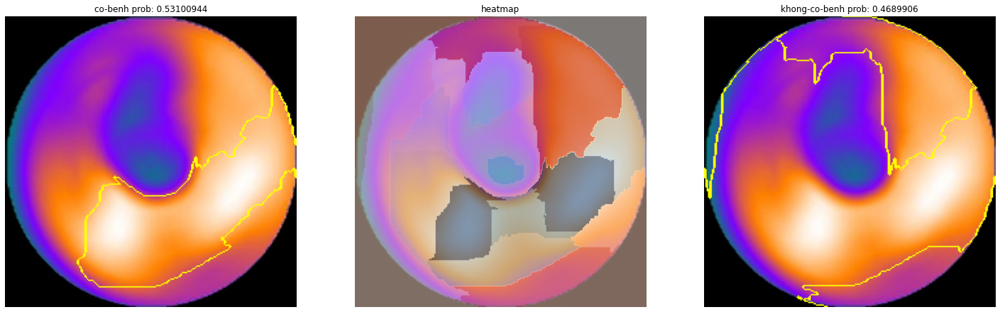

  0%|          | 0/2000 [00:00<?, ?it/s]

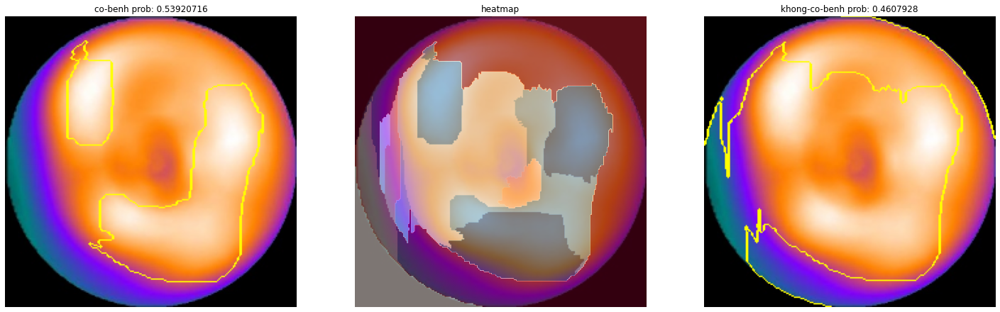

  0%|          | 0/2000 [00:00<?, ?it/s]

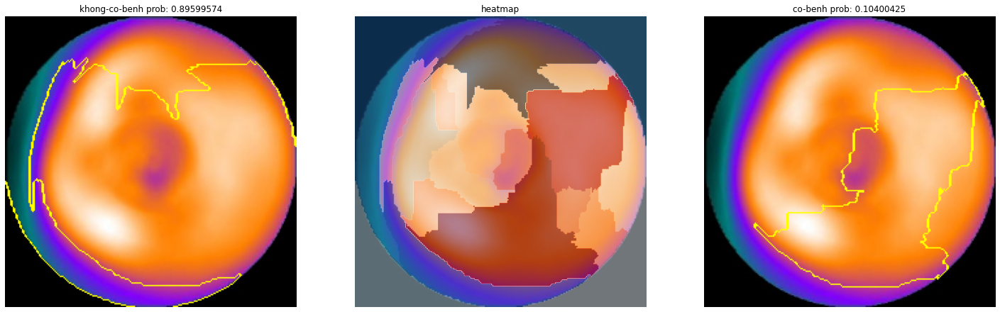

In [ ]:
for i in range(20,25):
  explain(imgPaths[i])

#gradcam

In [ ]:
best_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras

# Display
from IPython.display import Image, display
import matplotlib.pyplot as plt
import matplotlib.cm as cm

In [ ]:
def get_img_array(image):
  # image = cv2.imread(img_path)
  # image = cv2.resize(image,(224,224))
  # image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
  image = np.expand_dims(image, axis=0)
  # image = image.astype('float')/255.0
  return image

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

In [ ]:
def grad_cam(image, model, last_conv_layer_name):

  img_pred = np.expand_dims(image, axis=0)


  pred = model.predict(img_pred)
  
  index_0 = np.argmax(pred)


  # Generate class activation heatmap
  heatmap = make_gradcam_heatmap(img_pred, model,last_conv_layer_name)
  # heatmap = cv2.resize(heatmap,(224,224))
  return heatmap

**Insertion**

In [ ]:
def make_blur(image):
  for idx,x in enumerate(image):
    for idy,y in enumerate(x):
      image[idx][idy] =[0,0,0]
  return image
      

In [ ]:
def insertion(idx_img):
  acc = []
  image_origin = X_test[idx_img].copy()
  img_pred = np.expand_dims(image_origin,axis=0)
  preds = best_model.predict(img_pred)
  idx = np.argmax(preds)
  print(preds[0][idx])
  print(idx)
  image = make_blur(image_origin.copy())
  heatmap = grad_cam(image_origin,best_model,'conv5_block3_out')
  heatmap = cv2.resize(heatmap,(224,224))

  for i in np.arange(1,-0.01,-0.01):
    for idx_heatmap,heat_parent in enumerate(heatmap):
      for idx_heat,heat_child in enumerate(heat_parent):
        if heat_child>=i:
          image[idx_heatmap][idx_heat]=image_origin[idx_heatmap][idx_heat]
    temp = image.copy()
    temp = np.expand_dims(temp,axis=0)
    preds = best_model.predict(temp)
    acc.append(preds[0][idx])
  
# Visualization

  fig = plt.figure(figsize=(15,3))
  fig.add_subplot(131)
  plt.imshow(X_test2[idx_img])
  plt.axis('off')



  fig.add_subplot(132)
  x = np.arange(0, 1, 1/len(acc))
  plt.xlim(-0.1, 1.1)
  plt.ylim(0, 1.05)
  plt.fill_between(x, 0, acc, alpha=0.4)
  agv = average(acc)
  plt.plot(x,acc)
  

  # display mixing
  fig.add_subplot(133)
  plt.imshow(X_test2[idx_img])
  plt.imshow(heatmap,alpha =0.7)
  plt.axis('off')
  plt.show()
  return agv

0.8371938
1


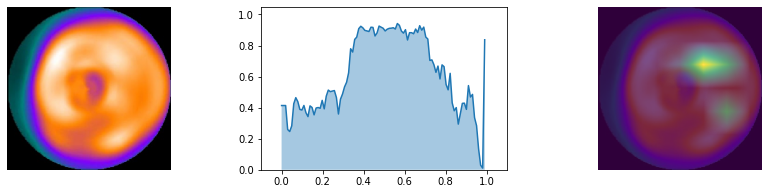

0.5737271
1


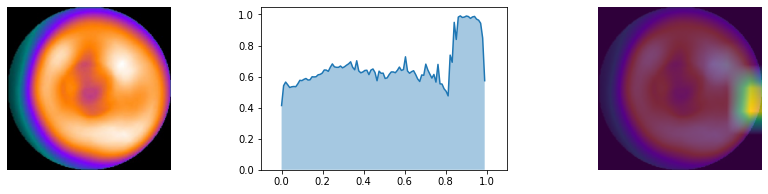

0.9271689
1


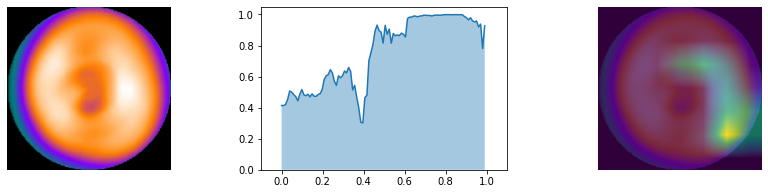

0.8753884
1


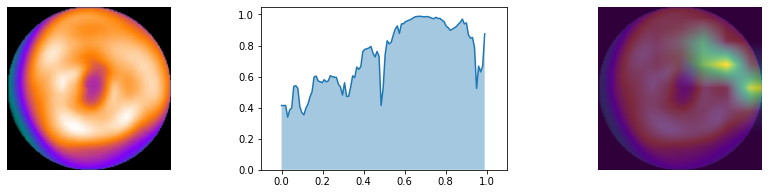

0.9998117
0


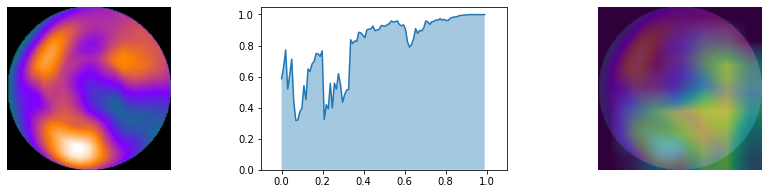

0.94136804
1


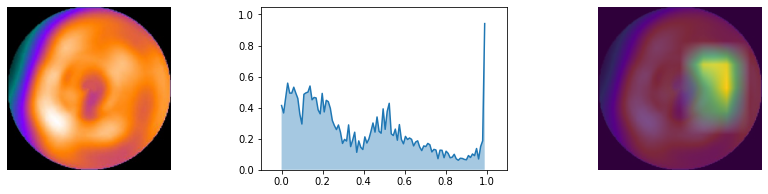

0.99302095
0


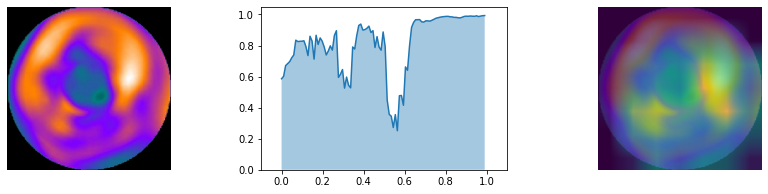

0.9949891
0


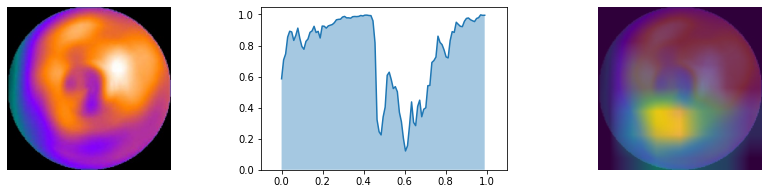

0.99873394
0


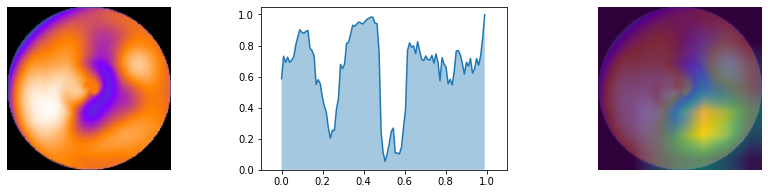

0.9286458
0


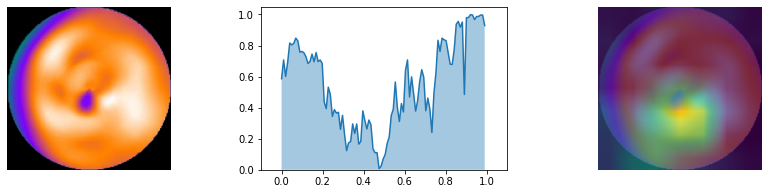

0.566802
0


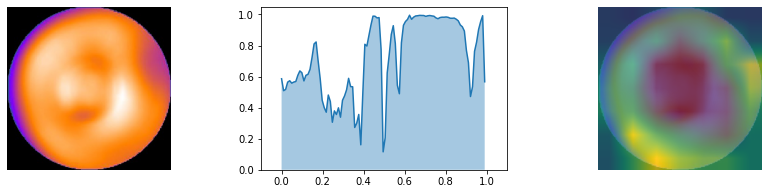

0.81882316
1


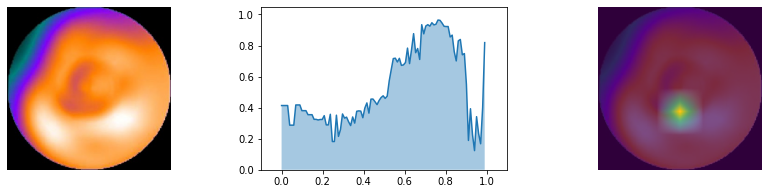

0.88758814
0


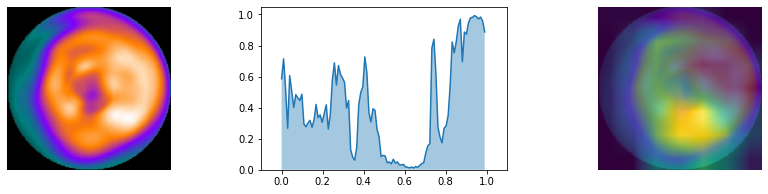

0.9775283
0


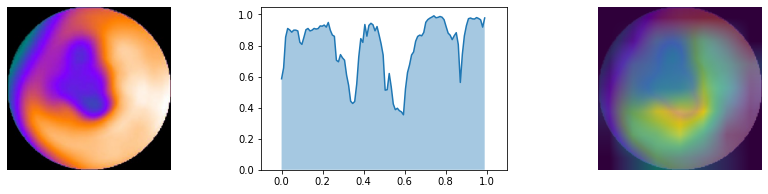

0.64681584
0


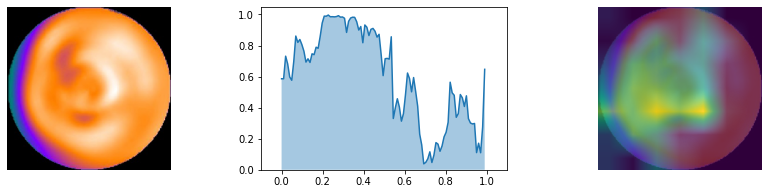

0.9713094
1


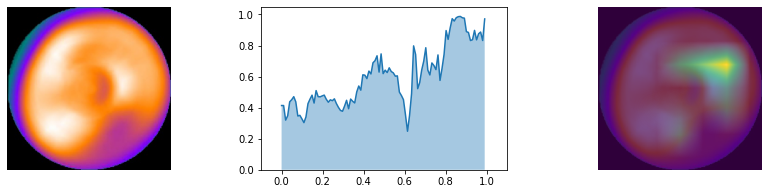

0.9581998
0


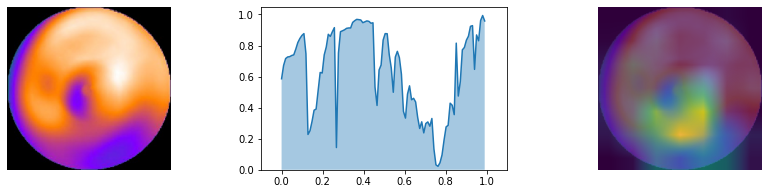

0.95371974
1


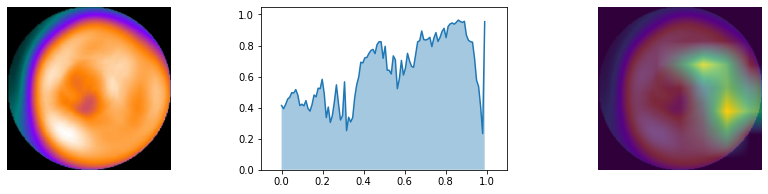

0.98198074
1


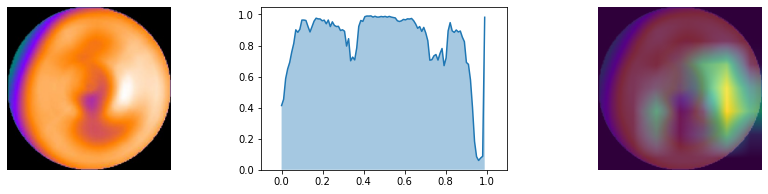

0.9938905
0


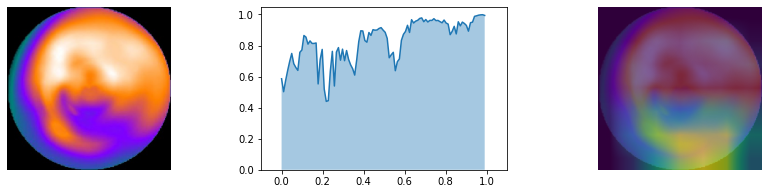

0.97187716
0


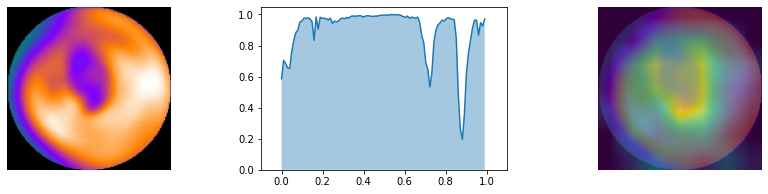

0.9191142
0


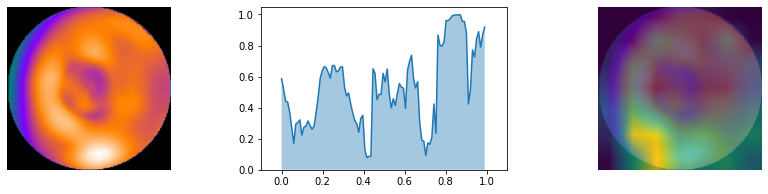

0.8763856
1


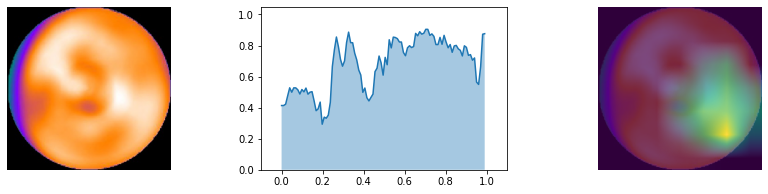

0.95777595
1


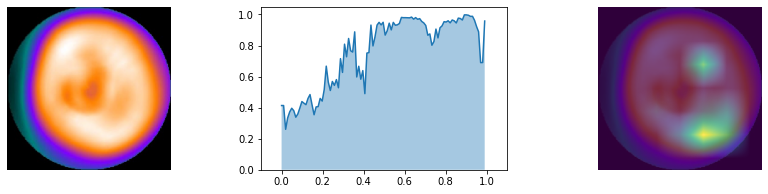

0.99190956
1


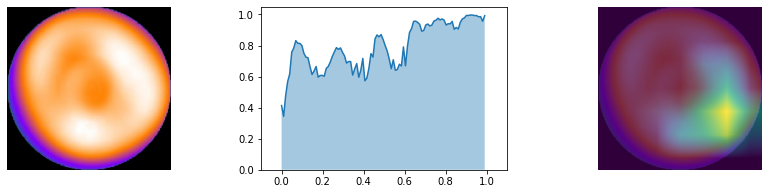

0.9640817
1


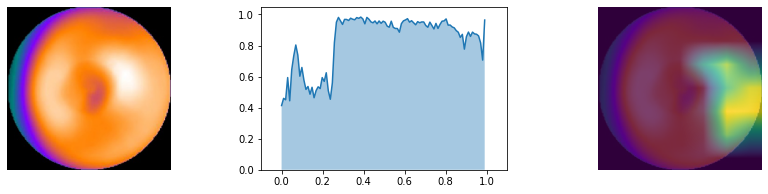

0.9969695
0


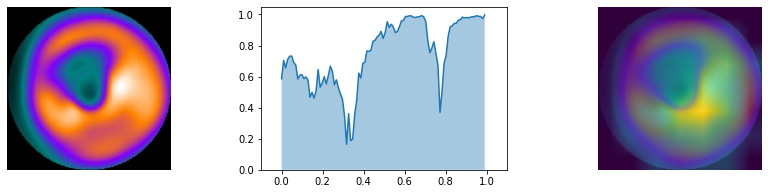

0.99580526
0


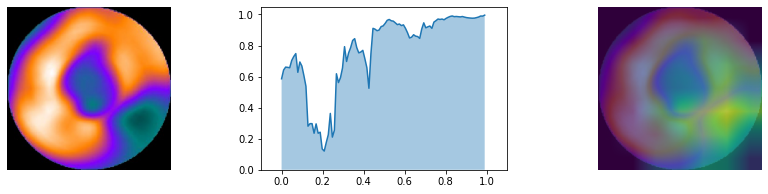

0.7056784
1


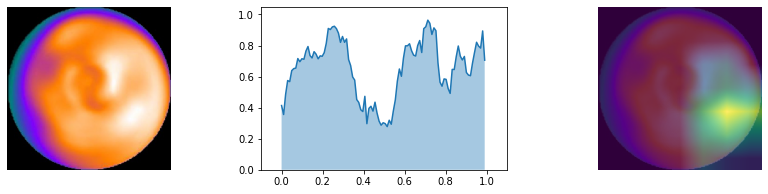

0.888735
1


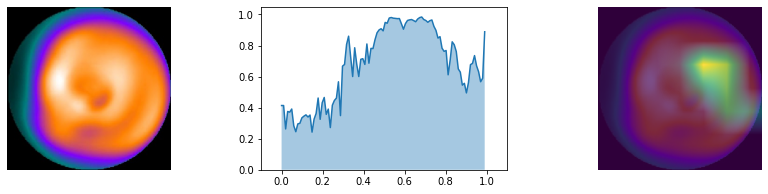

0.9827291
1


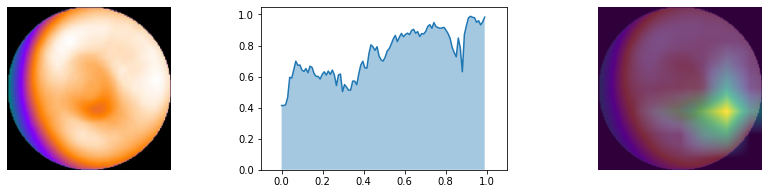

0.75511754
0


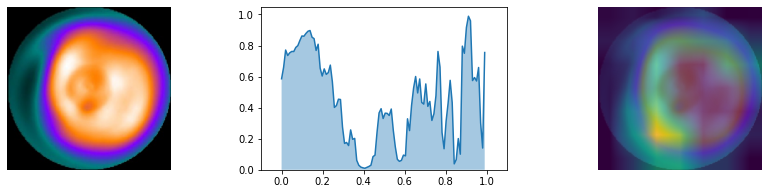

0.8194351
0


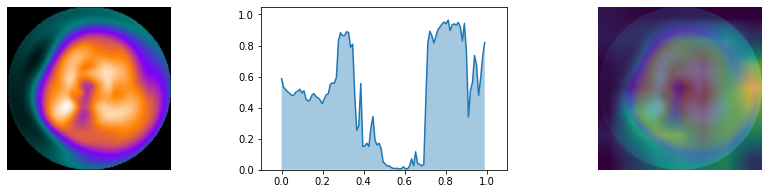

0.90157104
1


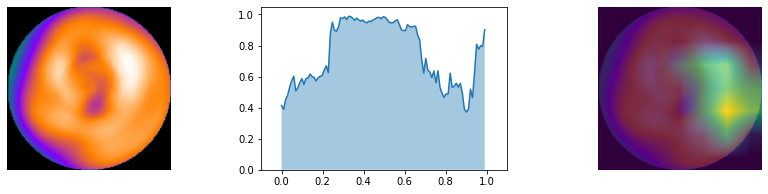

0.95016193
1


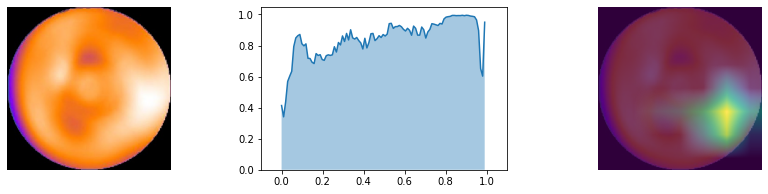

0.9074519
1


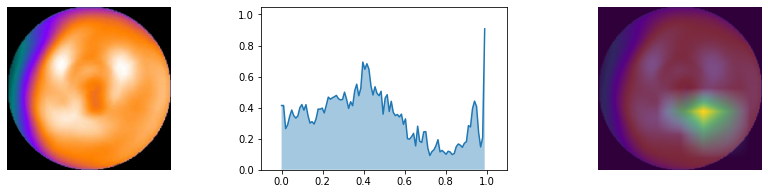

0.5019193
0


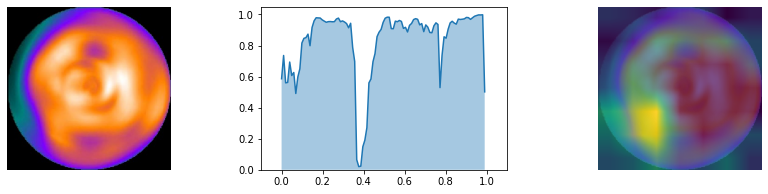

0.9988299
0


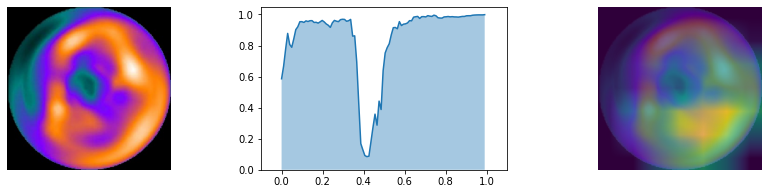

0.9806476
0


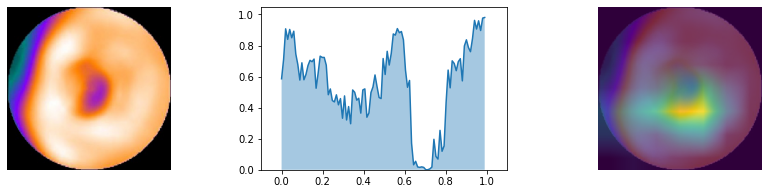

0.9421961
1


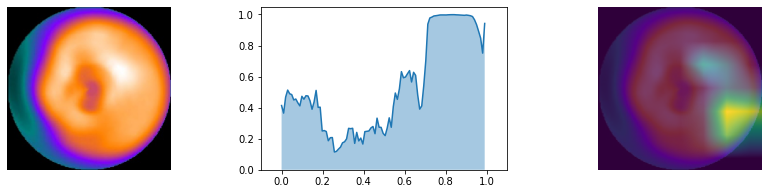

0.7824104
1


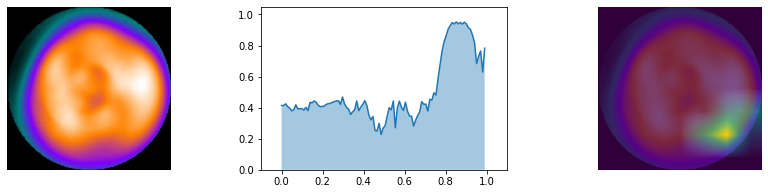

0.8808057
1


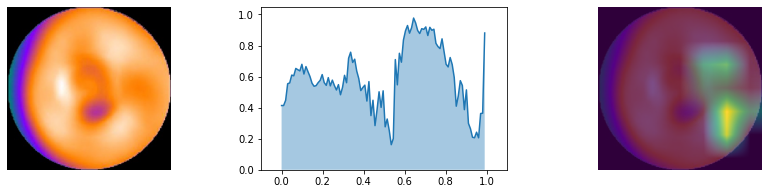

0.9526393
1


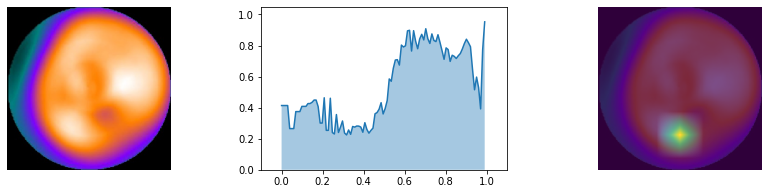

0.8050425
1


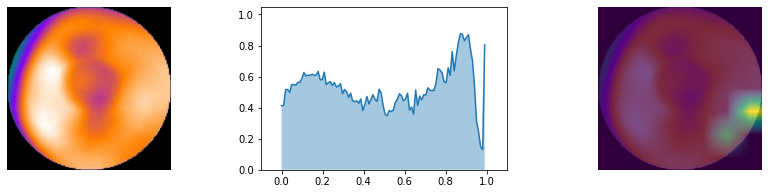

In [ ]:
list_acc = []
for i in range(len(X_test)):
  list_acc.append(insertion(i))

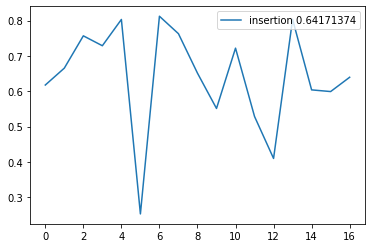

In [ ]:
list_crop = list_acc[:17]
x = np.arange(0, 17, 17/len(list_crop))
plt.plot(x,list_crop,label='insertion '+str(average(list_crop)))
plt.legend(loc='upper right')
plt.show()

**Deletion**

In [ ]:
def deletion(idx_img):
  acc = []
  img_preds = np.expand_dims(X_test[idx_img],axis=0)
  preds = best_model.predict(img_preds)


  idx = np.argmax(preds)
  print(idx)
  print(preds[0][idx])
  image = X_test[idx_img].copy()
  heatmap = grad_cam(image,best_model,'conv5_block3_out')
  heatmap = cv2.resize(heatmap,(224,224))
  for i in np.arange(1.0,0,-0.01):
    for idx_heatmap,heat_parent in enumerate(heatmap):
      for idx_heat,heat_child in enumerate(heat_parent):
        if heat_child>=i:
          image[idx_heatmap][idx_heat]=[0,0,0]
   
    temp = image.copy()
    temp = np.expand_dims(temp,axis=0)
    preds = best_model.predict(temp)
    acc.append(preds[0][idx])
  

# Visualization

  fig = plt.figure(figsize=(15,3))
  fig.add_subplot(131)
  plt.imshow(X_test2[idx_img])
  plt.axis('off')



  fig.add_subplot(132)
  x = np.arange(0, 1, 1/len(acc))
  plt.xlim(-0.1, 1.1)
  plt.ylim(0, 1.05)
  plt.fill_between(x, 0, acc, alpha=0.4)
  agv = average(acc)
  plt.plot(x,acc)
  

  # display mixing
  fig.add_subplot(133)
  plt.imshow(X_test2[idx_img])
  plt.imshow(heatmap,alpha =0.7)
  plt.axis('off')
  plt.show()
  return agv

In [ ]:
list_acc = []

1
0.8371938


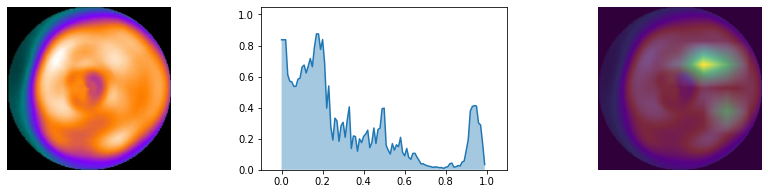

1
0.57372624


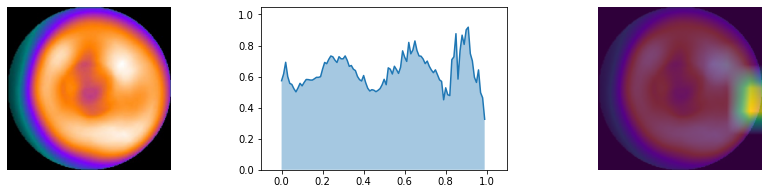

1
0.9271687


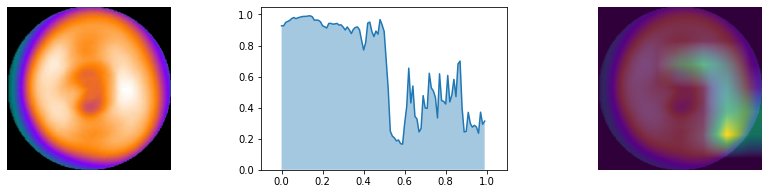

1
0.875387


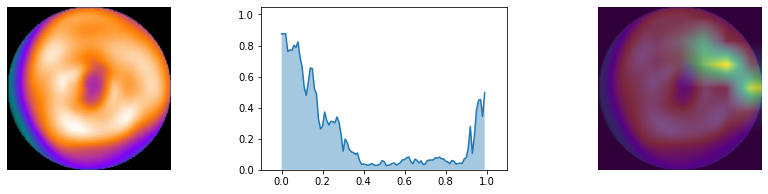

0
0.9998117


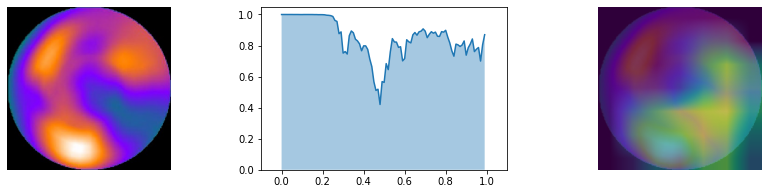

1
0.94136846


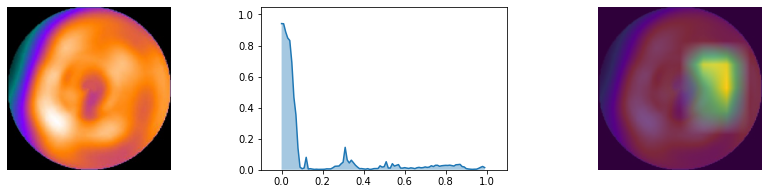

0
0.99302095


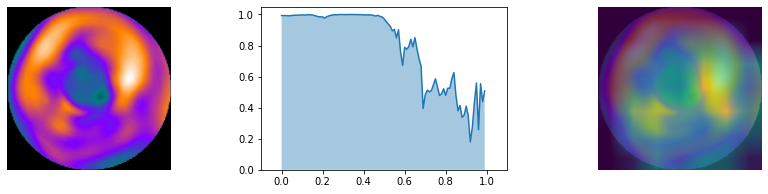

0
0.994989


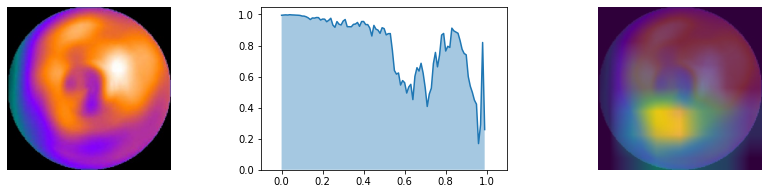

0
0.99873394


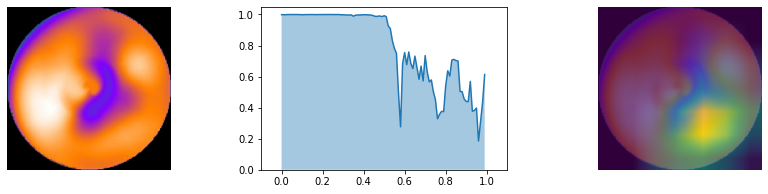

0
0.9286459


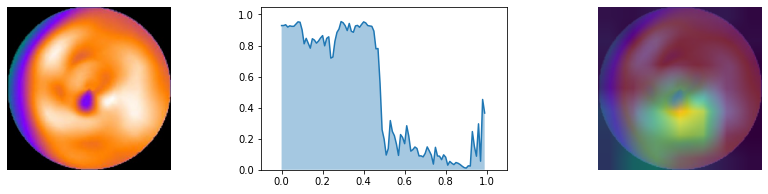

0
0.5668013


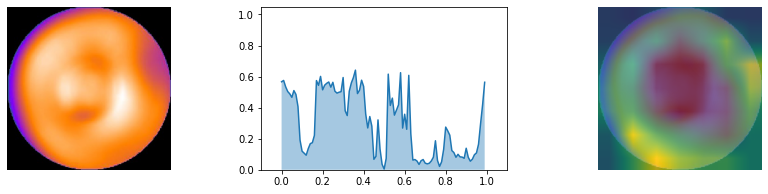

1
0.81882346


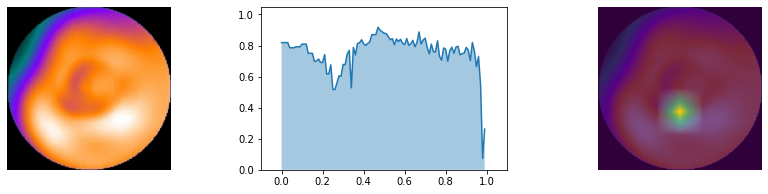

0
0.8875883


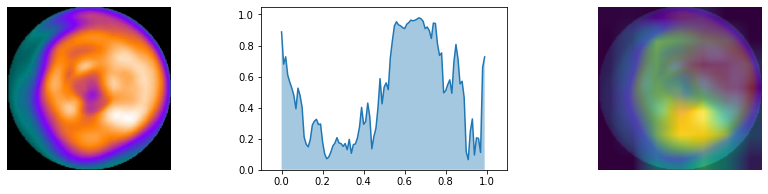

0
0.9775283


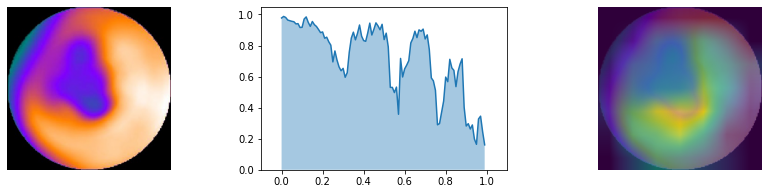

0
0.6468159


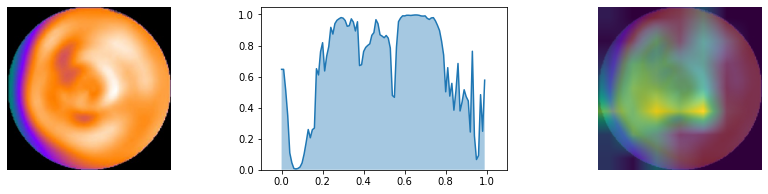

1
0.9713093


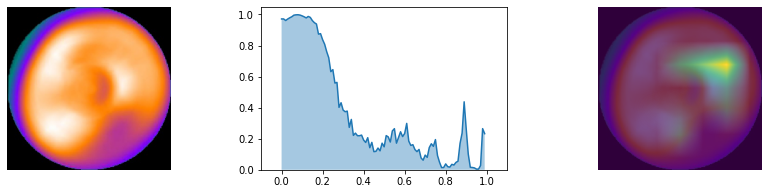

0
0.9581997


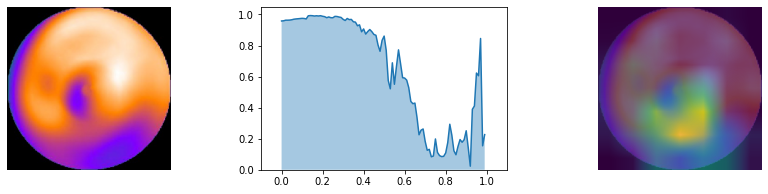

1
0.95371985


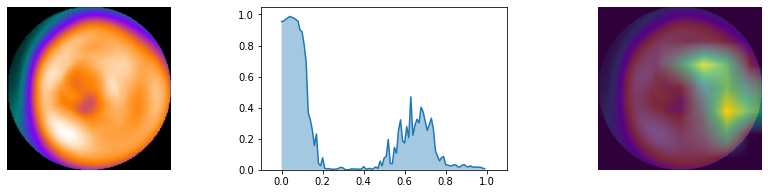

1
0.98198074


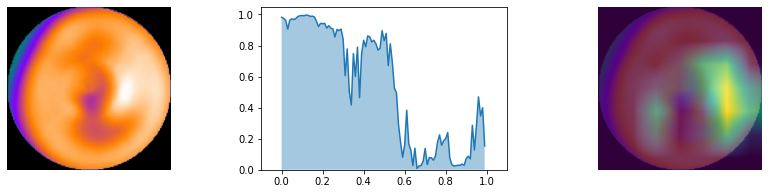

0
0.9938905


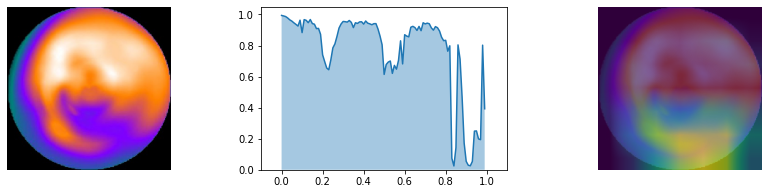

0
0.97187716


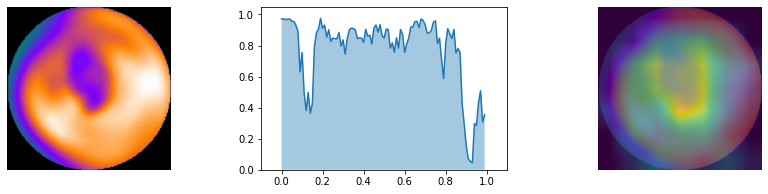

0
0.919114


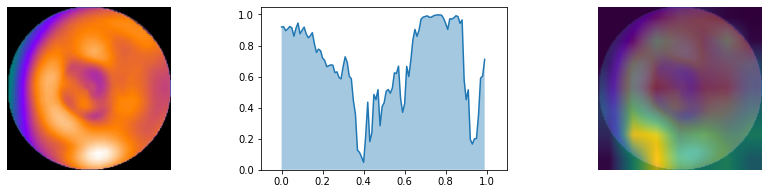

1
0.8763856


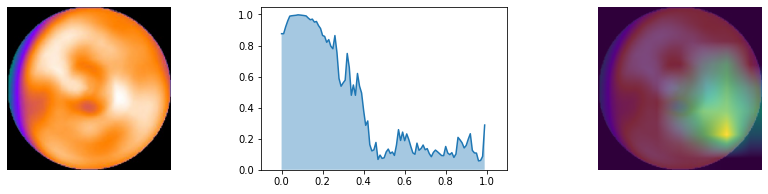

1
0.9577758


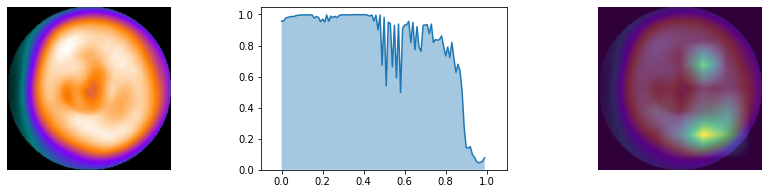

1
0.9919097


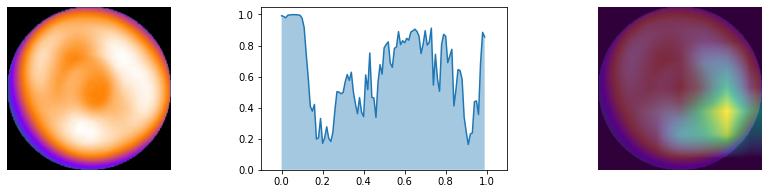

1
0.9640817


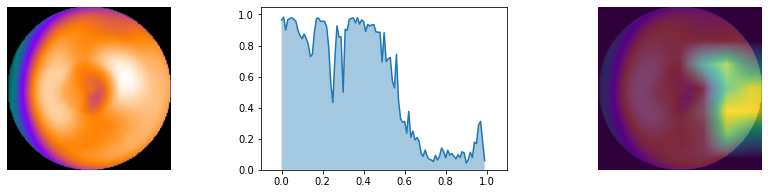

0
0.99696964


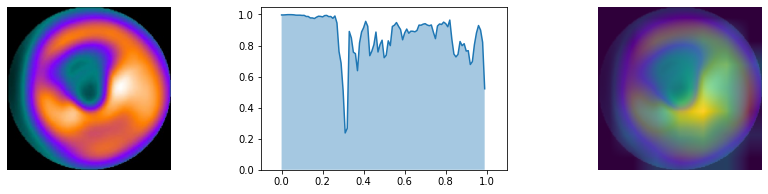

0
0.99580526


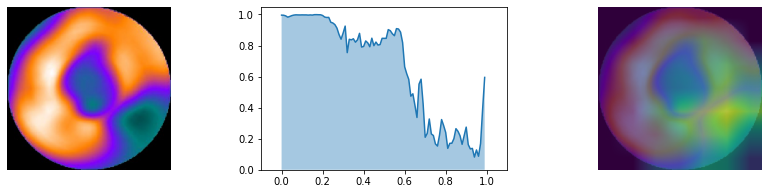

1
0.705679


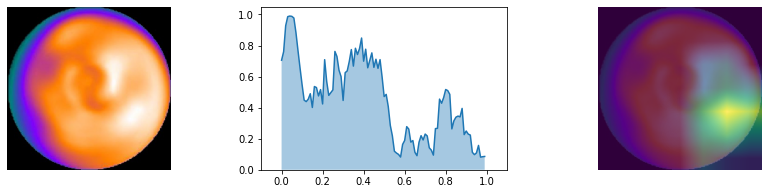

1
0.8887343


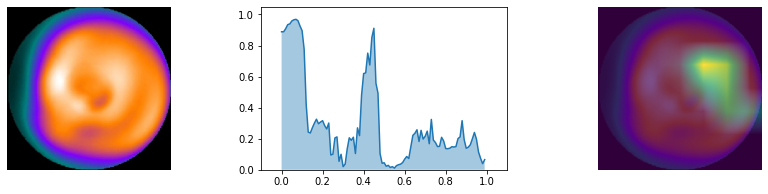

1
0.98272896


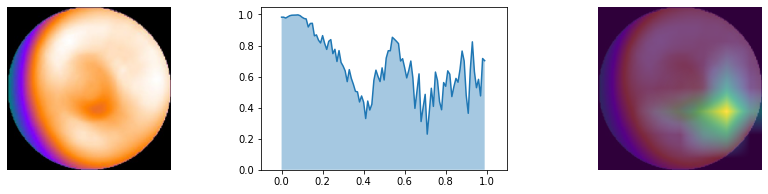

0
0.7551182


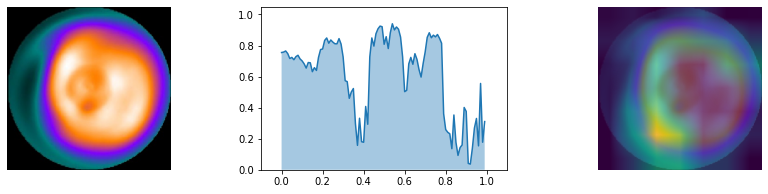

0
0.8194349


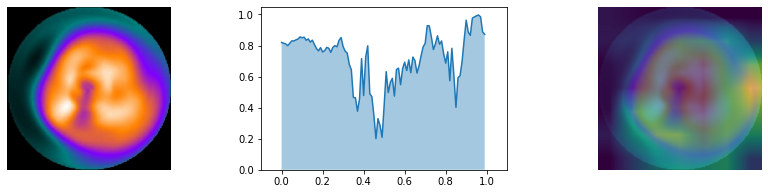

1
0.9015712


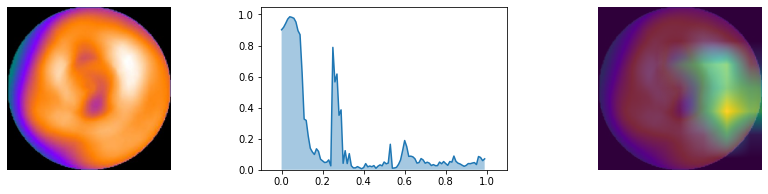

1
0.9501621


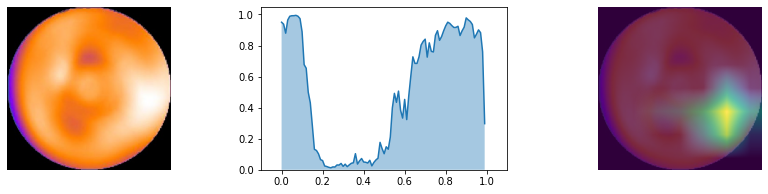

1
0.9074522


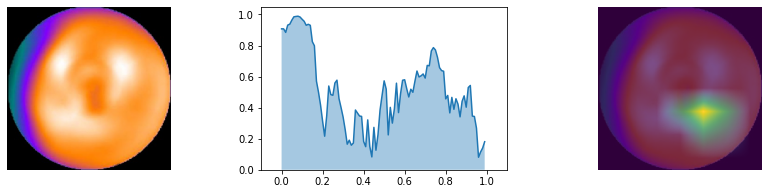

0
0.50191987


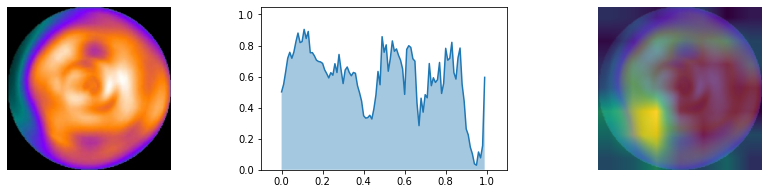

0
0.9988299


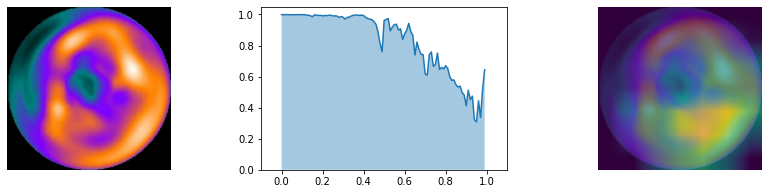

0
0.9806476


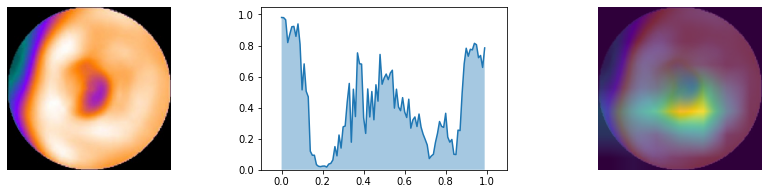

1
0.9421962


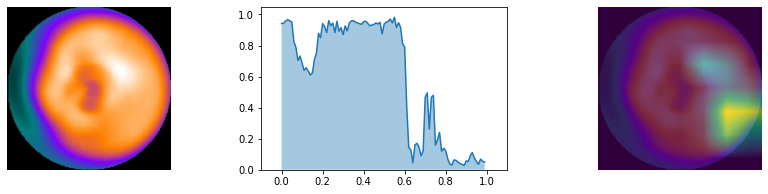

1
0.7824109


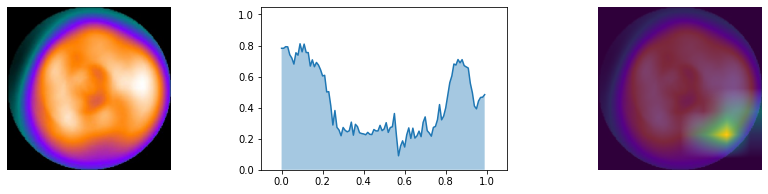

1
0.880806


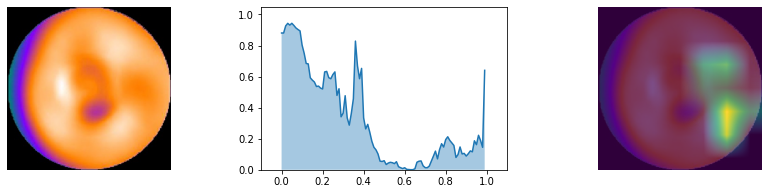

1
0.9526393


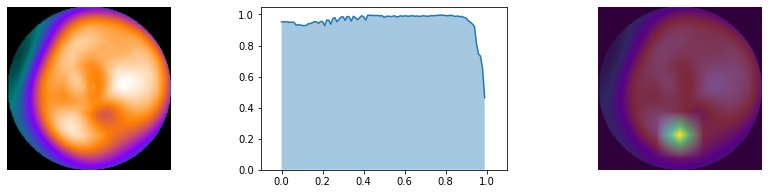

1
0.80504256


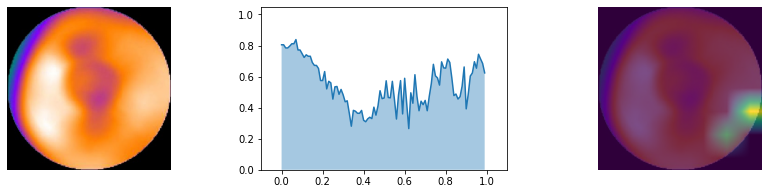

In [ ]:
for i in range(len(X_test)):
  list_acc.append(deletion(i))

In [ ]:
print(list_acc)

[0.28283247, 0.63678086, 0.6683705, 0.22876398, 0.8479252, 0.07920425, 0.7973008, 0.80472314, 0.7935876, 0.49659935, 0.29917714, 0.75749826, 0.4961202, 0.72118217, 0.6766772, 0.36817956, 0.6480168, 0.20588341, 0.5412607, 0.7728833, 0.7748901, 0.6784508, 0.41380578, 0.8176332, 0.6318546, 0.55499816, 0.87010497, 0.6632829, 0.45519853, 0.30036753, 0.67061096, 0.6121862, 0.7169269, 0.17956331, 0.50278026, 0.50964695, 0.59173745, 0.833741, 0.4243761, 0.5948311, 0.427045, 0.32610387, 0.95908624, 0.54801035]


In [ ]:
list_crop = list_acc[:13]

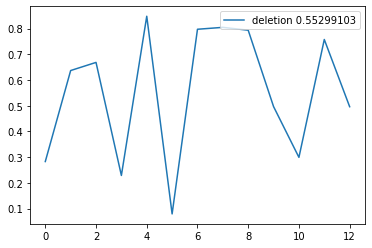

In [ ]:
x = np.arange(0, 13, 13/len(list_crop))
plt.plot(x,list_crop,label='deletion '+str(average(list_crop)))
plt.legend(loc='upper right')
plt.show()

#RISE

In [ ]:
import tensorflow as tf
from PIL import Image
import numpy as np
from matplotlib import pyplot as plt

In [ ]:
!git clone https://github.com/palatos/RISE_tf

Cloning into 'RISE_tf'...
remote: Enumerating objects: 52, done.
remote: Counting objects: 100% (52/52), done.
remote: Compressing objects: 100% (42/42), done.
remote: Total 52 (delta 14), reused 43 (delta 10), pack-reused 0
Unpacking objects: 100% (52/52), done.


(-0.5, 223.5, 223.5, -0.5)

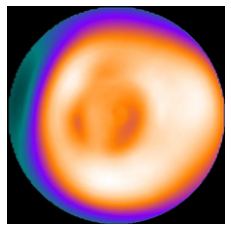

In [ ]:
image = Image.open(imgPaths[0])
image = np.array(image.resize((224,224)))
plt.figure(facecolor='white')
plt.imshow(image)
plt.axis('off')

In [ ]:
from RISE_tf.explain_image import RISE

explainer = RISE()
heatmaps, masks = explainer.explain(image,best_model)

In [ ]:
img = cv2.imread(imgPaths[0])
img = cv2.resize(img, dsize=(224, 224))
img = img.astype('float')*1./255
img = np.expand_dims(img, axis=0)
predict = best_model.predict(img)
idx = np.argmax(predict)
print("This picture is: ", labels[np.argmax(predict[0])], (predict[0]))
print(np.max(predict[0],axis=0))

This picture is:  0 [0.09795904 0.9020409 ]
0.9020409


(-0.5, 223.5, 223.5, -0.5)

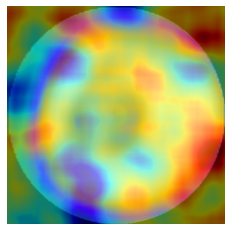

In [ ]:
plt.imshow(image)
plt.imshow(heatmaps[idx],cmap='jet',alpha=0.5)
plt.axis('off')

#LIME

In [ ]:
!pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 275 kB 9.4 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=5b86fbc6dd2fd4ec1f0cf8f5dd3bd8081a9a4f1def76c77a8e75974c18f155e4
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime


In [ ]:
from lime import lime_image

In [ ]:
def remove_mask(temp,mask):
  for i,x in enumerate(mask):
    for j,y in enumerate(x):
      if(y!=0):
        temp[i][j]=0
  return temp,mask

In [ ]:
def blur_mask(temp,mask):
  for i,x in enumerate(mask):
    for j,y in enumerate(x):
      if(y!=0):
        temp[i][j]/=9
  return temp,mask

In [ ]:
from numpy.lib.function_base import average


Insertion and Deletion LIME

In [ ]:
from skimage.segmentation import mark_boundaries

In [ ]:
def deletion_insertion():
  list_ins = []
  list_del = []
  for index,img in  enumerate(X_test):
    explainer = lime_image.LimeImageExplainer()
    explanation = explainer.explain_instance(img, best_model.predict, top_labels=2,  num_samples=100)
    idx = explanation.top_labels[0]
    num_of_superpx = len(explanation.local_exp[idx])
    # insertion
    acc_ins = []
    for i in range(int(num_of_superpx),-1,-1):
      temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False,num_features=i, hide_rest=False)

      temp,mask = blur_mask(temp,mask)

      temp = np.expand_dims(temp,axis=0)

      preds = best_model.predict(temp)
      
      acc_ins.append(preds[0][idx])
    print('insertion')
    fig = plt.figure(figsize=(15,3))
    fig.add_subplot(131)
    plt.imshow(X_test2[index])
    plt.axis('off')

    fig.add_subplot(132)
    x = np.arange(0, 1, 1/len(acc_ins))
    plt.xlim(-0.1, 1.1)
    plt.ylim(0, 1.05)
    plt.fill_between(x, 0, acc_ins, alpha=0.4)
    plt.plot(x,acc_ins)

    
    temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False,num_features=len(explanation.local_exp[idx]), hide_rest=False)
    fig.add_subplot(133)
   
    plt.imshow(mark_boundaries(X_test2[index], mask))
    # plt.imshow(temp,alpha = 0.5)
    plt.show()

    print('deletion')
    acc_del = []
    for i in range(0,int(num_of_superpx)+1,1):
      temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False,num_features=i, hide_rest=False)
      temp,mask = remove_mask(temp,mask)
      temp = np.expand_dims(temp,axis=0)
      preds = best_model.predict(temp)
      acc_del.append(preds[0][idx])



  
    fig = plt.figure(figsize=(15,3))
    fig.add_subplot(131)
    plt.imshow(X_test2[index])
    plt.axis('off')

    fig.add_subplot(132)



    x = np.arange(0, 1, 1/len(acc_del))
    plt.xlim(-0.1, 1.1)
    plt.ylim(0, 1.05)
    plt.fill_between(x, 0, acc_del, alpha=0.4)
    plt.plot(x,acc_del)


    temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False,num_features=len(explanation.local_exp[idx]), hide_rest=False)
    fig.add_subplot(133)
   
    plt.imshow(mark_boundaries(X_test2[index], mask))
    plt.axis('off')
    # plt.imshow(temp,alpha = 0.5)
    plt.show()

    plt.plot(acc_ins,label='insertion'+str(average(acc_ins)))
    plt.plot(acc_del,label='deletion'+str(average(acc_del)))
    list_ins.append(average(acc_ins))
    list_del.append(average(acc_del))
    plt.legend(loc='upper left')
    plt.show()
  return list_ins,list_del

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


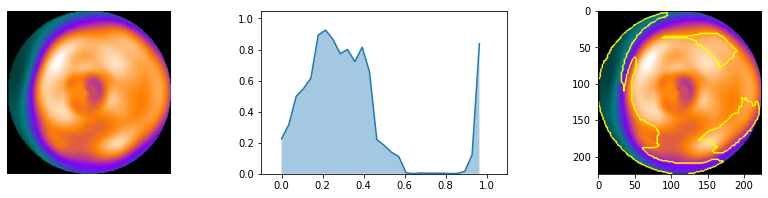

deletion


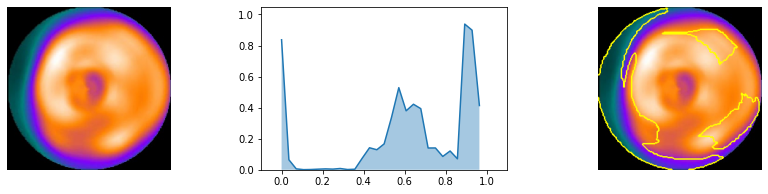

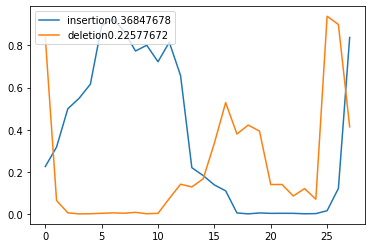

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


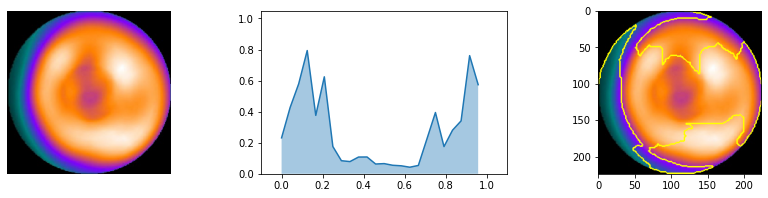

deletion


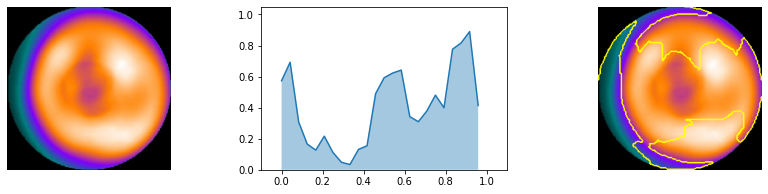

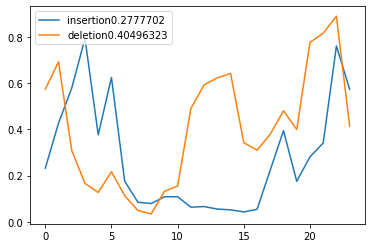

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


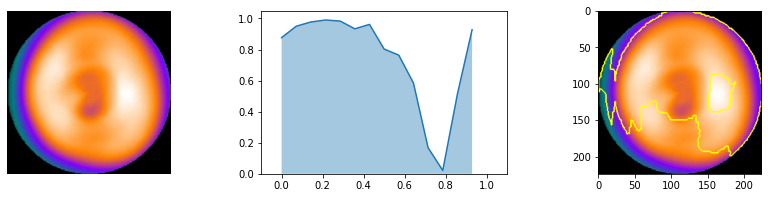

deletion


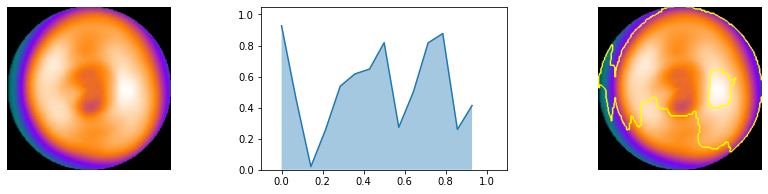

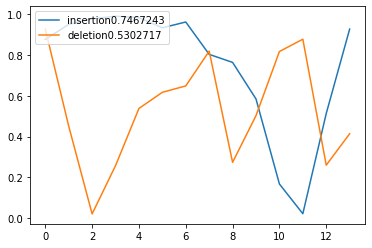

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


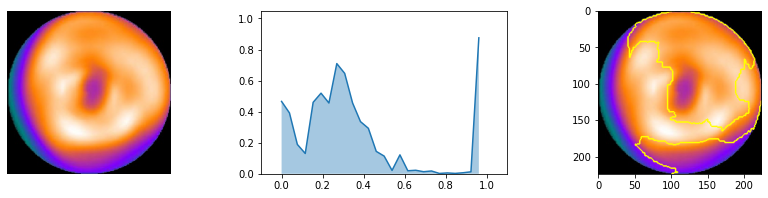

deletion


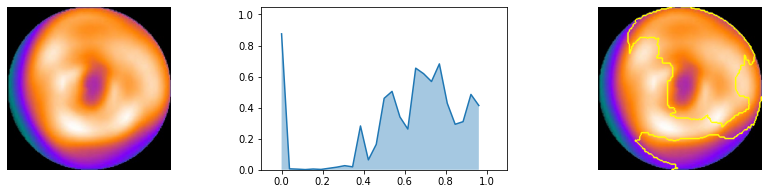

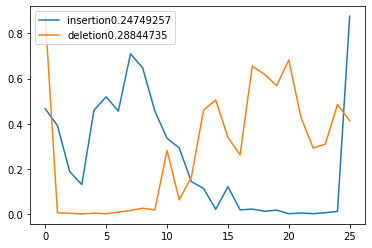

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


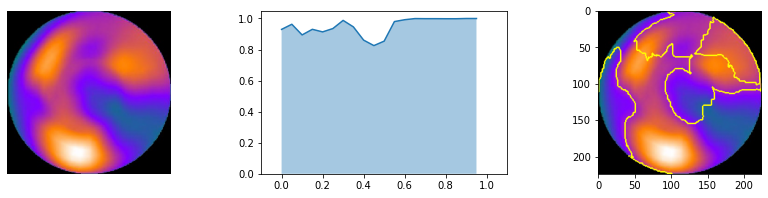

deletion


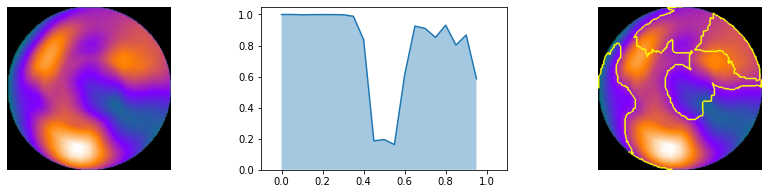

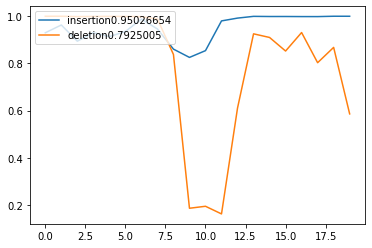

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


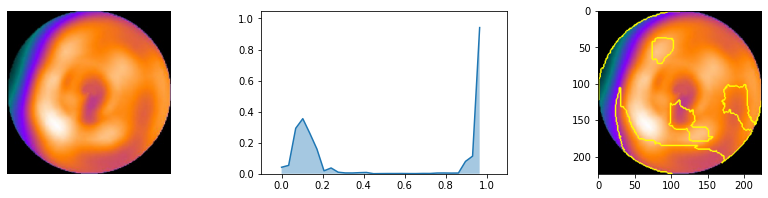

deletion


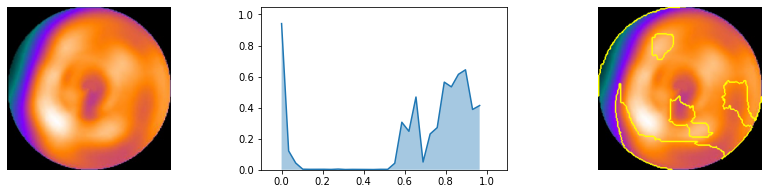

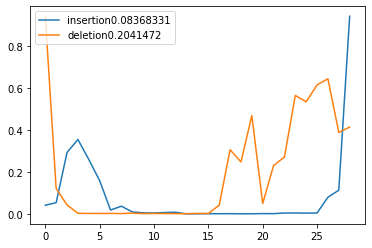

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


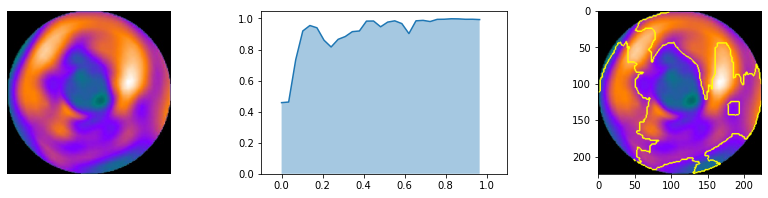

deletion


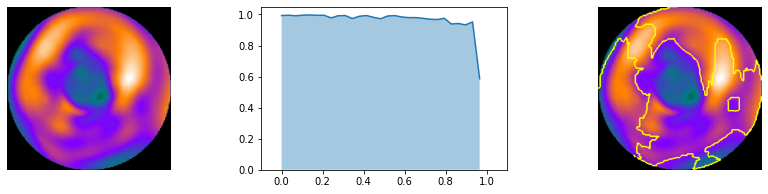

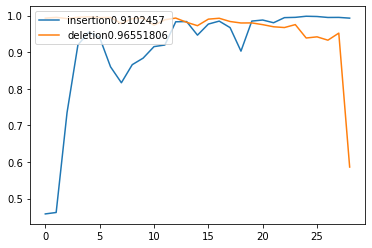

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


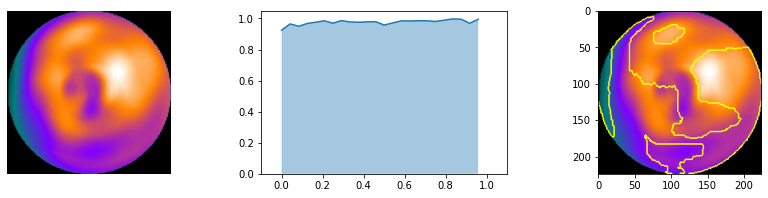

deletion


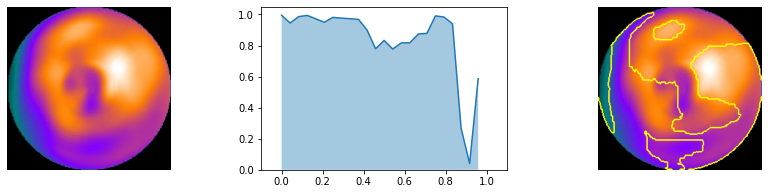

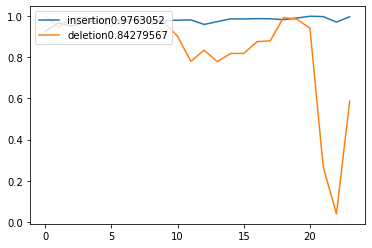

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


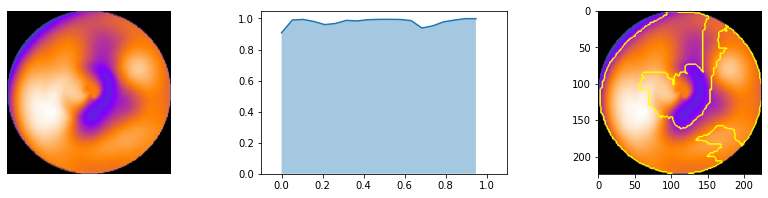

deletion


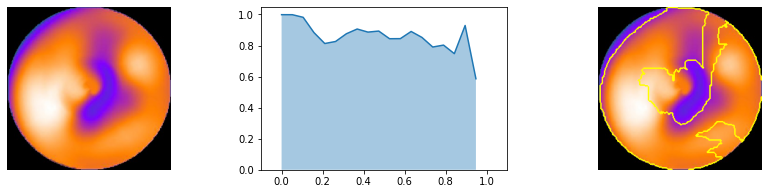

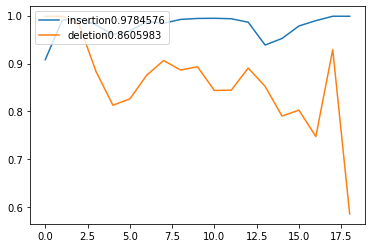

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


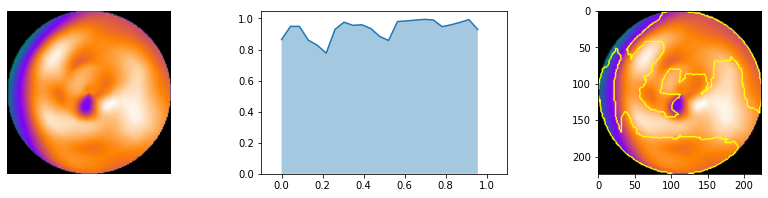

deletion


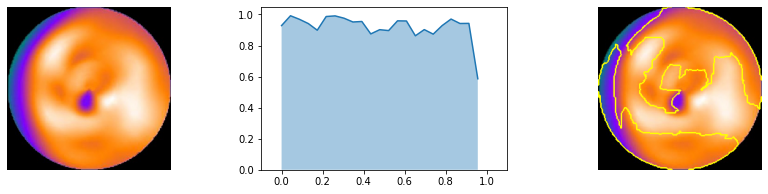

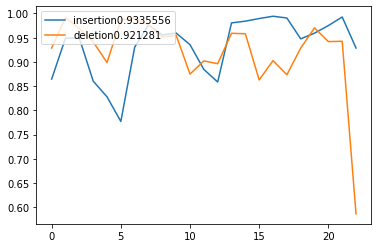

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


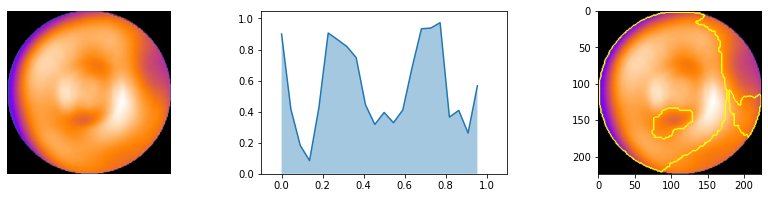

deletion


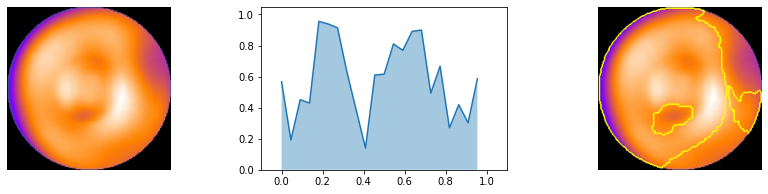

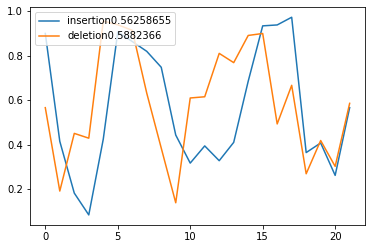

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


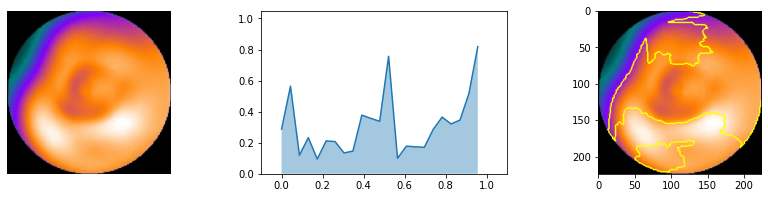

deletion


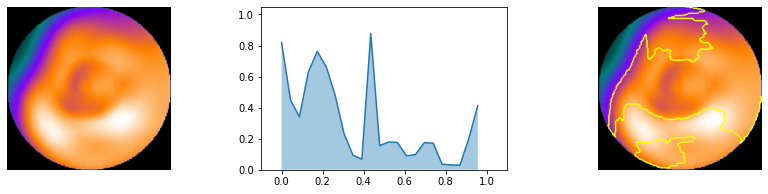

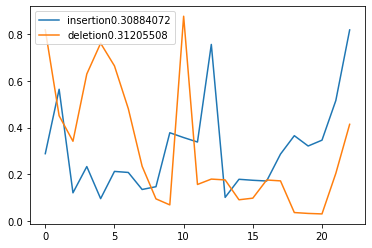

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


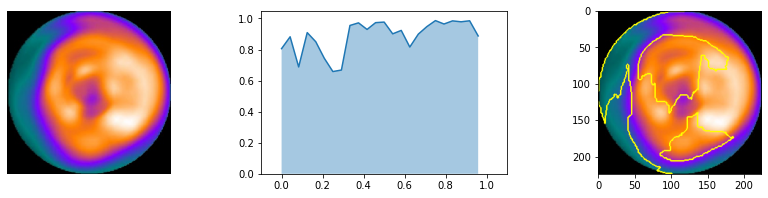

deletion


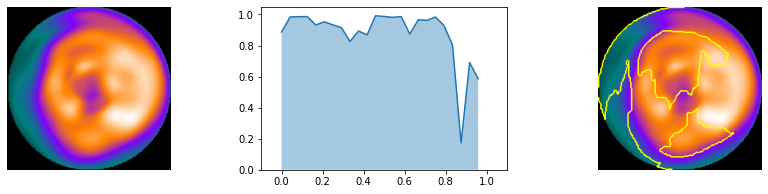

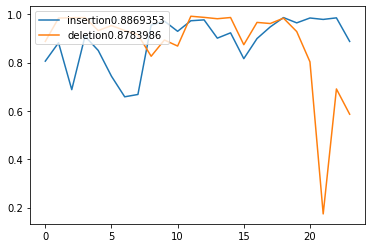

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


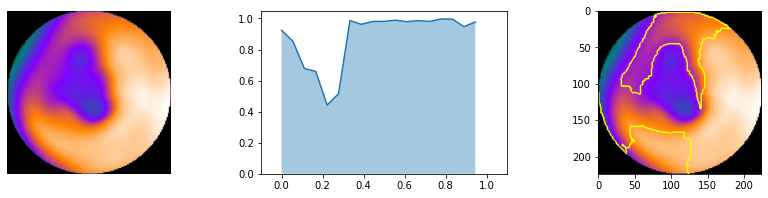

deletion


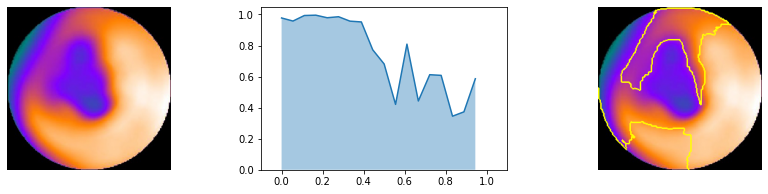

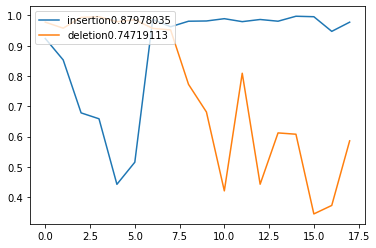

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


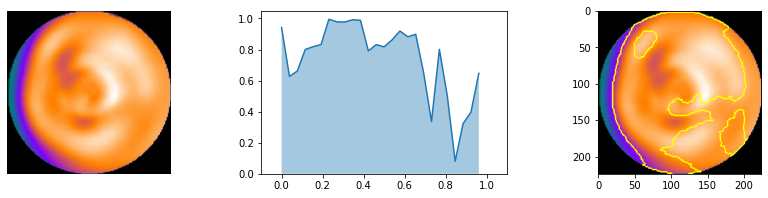

deletion


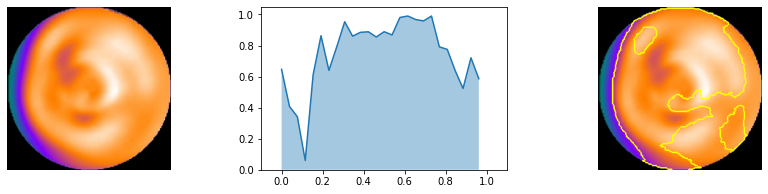

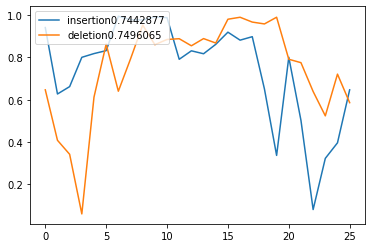

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


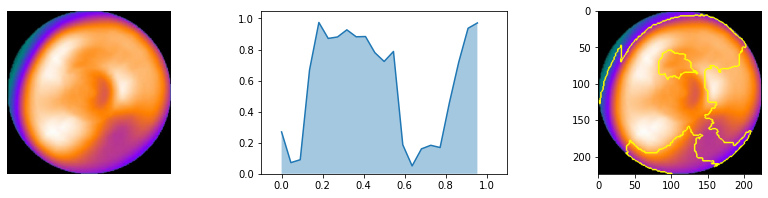

deletion


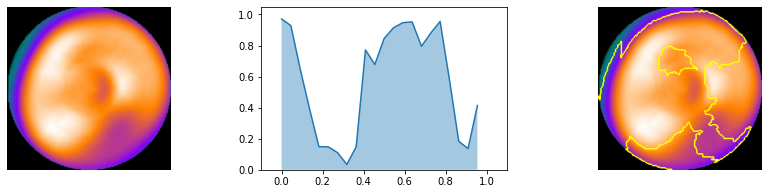

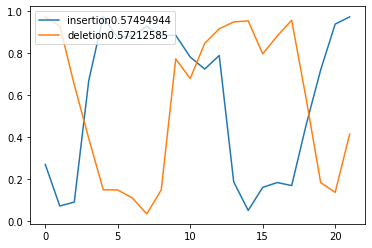

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


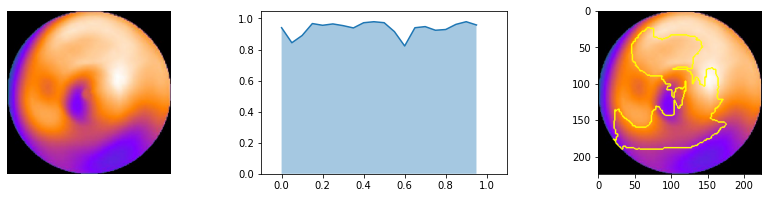

deletion


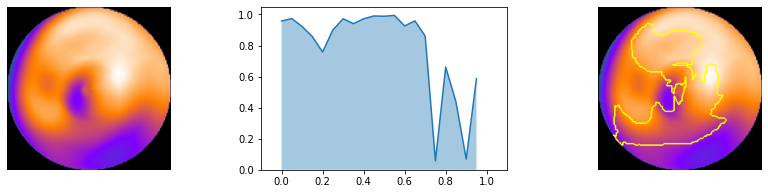

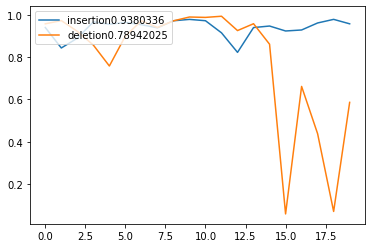

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


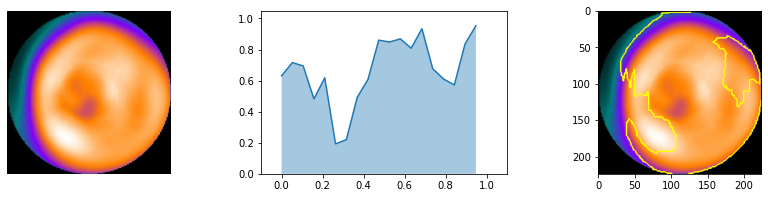

deletion


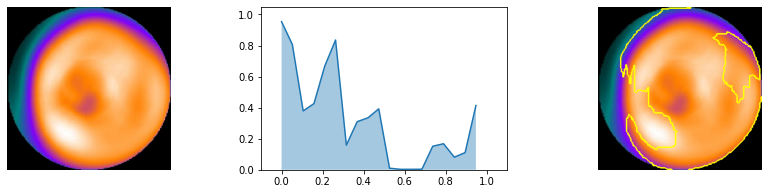

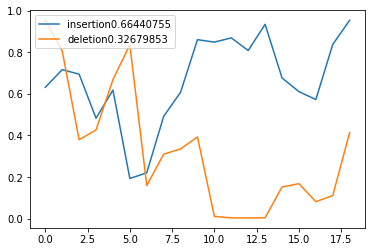

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


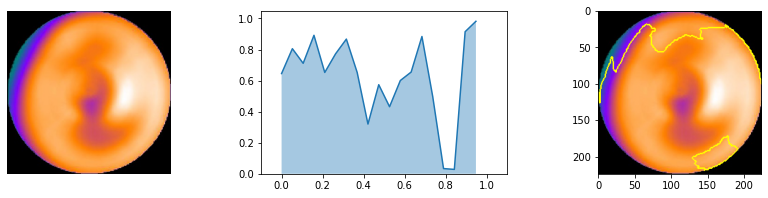

deletion


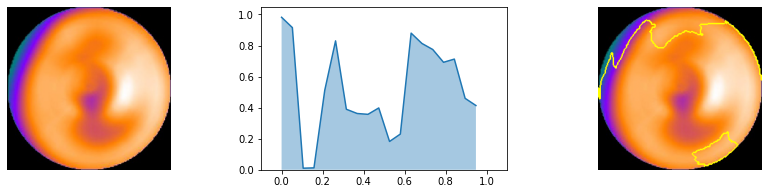

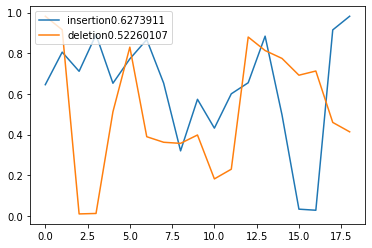

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


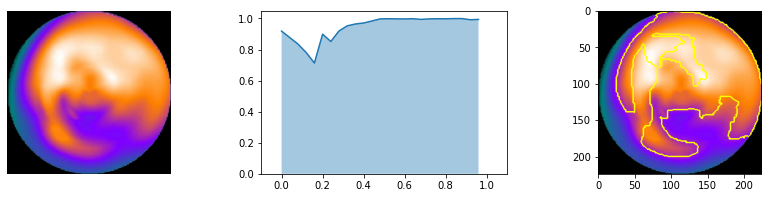

deletion


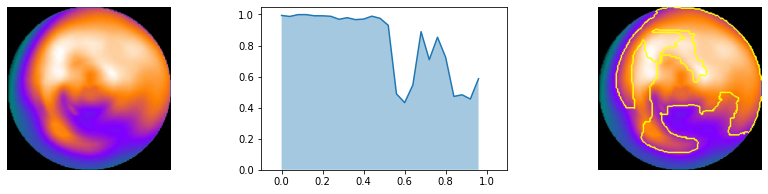

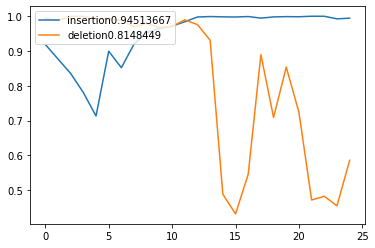

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


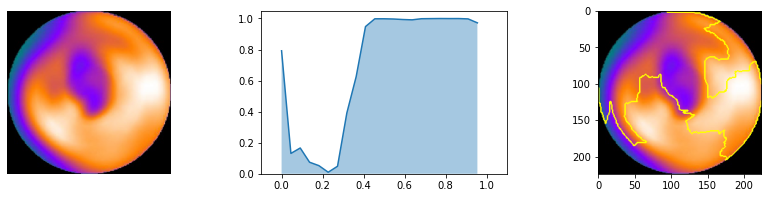

deletion


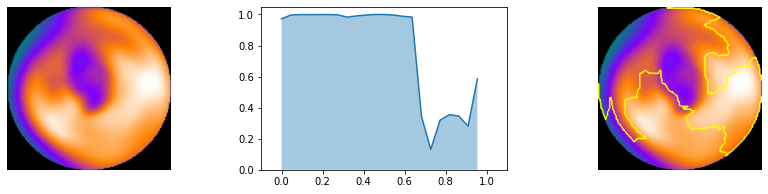

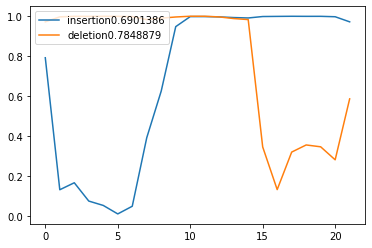

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


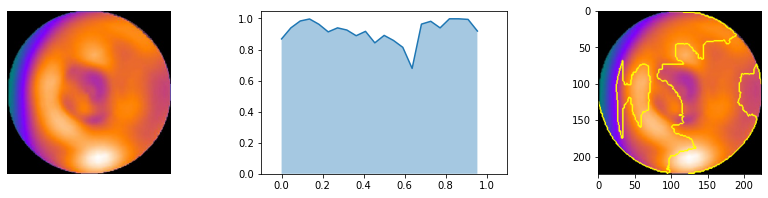

deletion


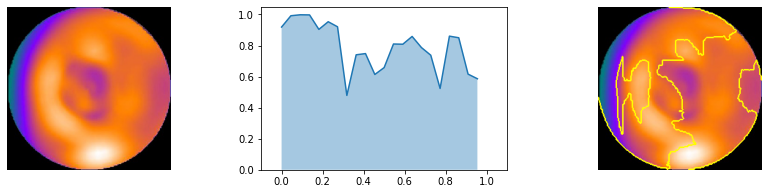

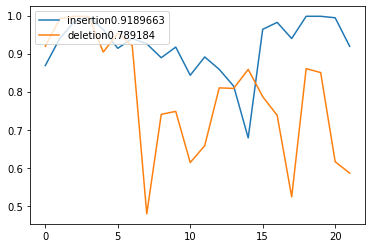

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


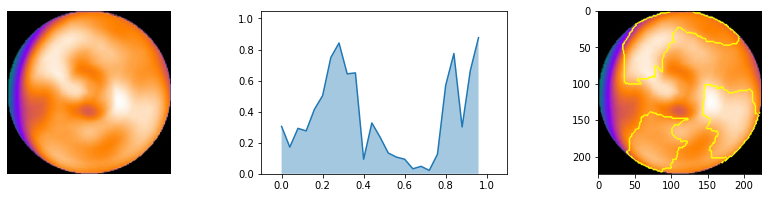

deletion


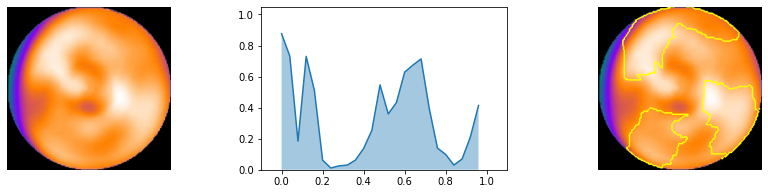

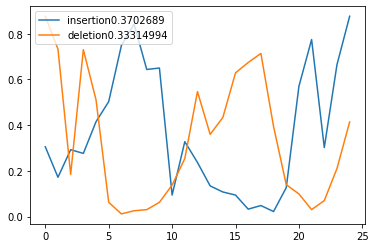

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


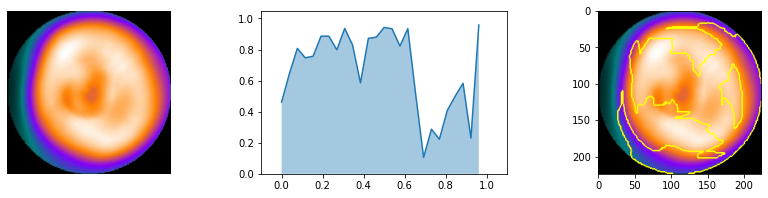

deletion


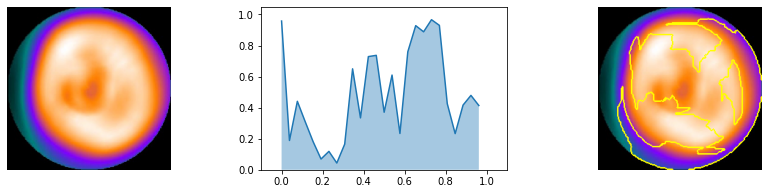

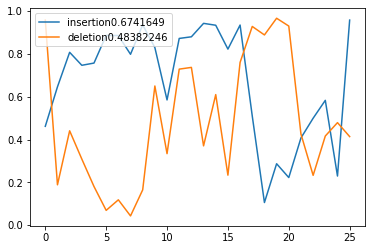

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


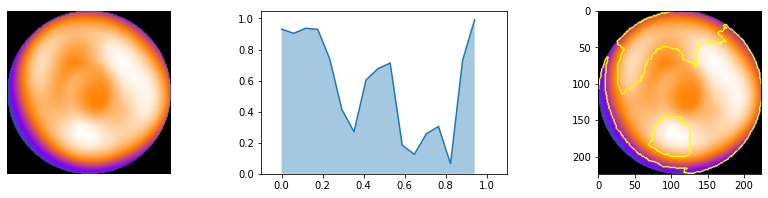

deletion


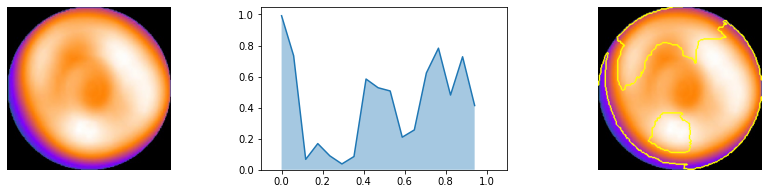

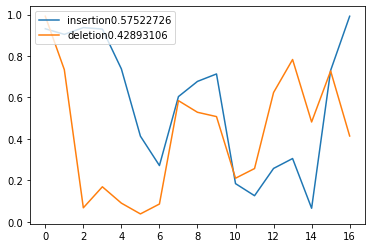

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


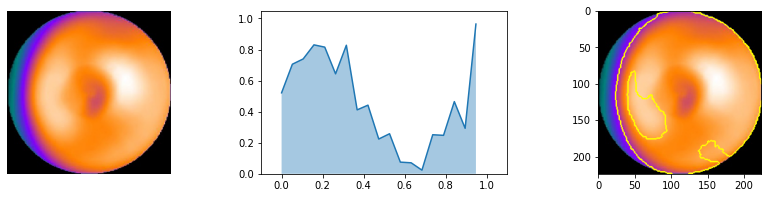

deletion


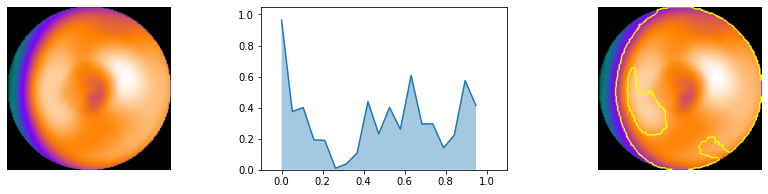

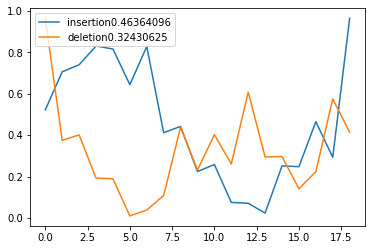

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


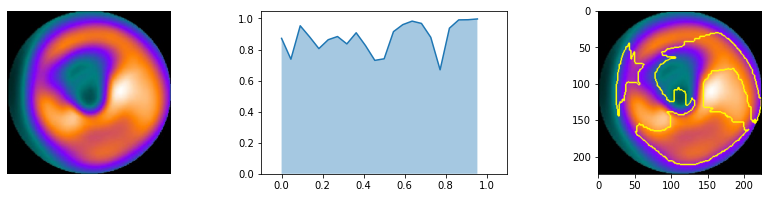

deletion


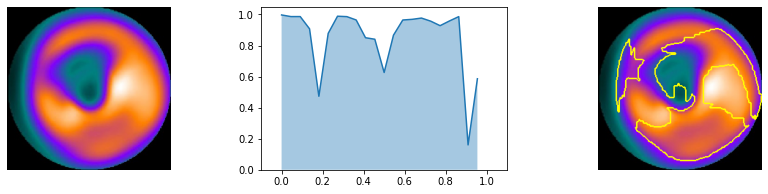

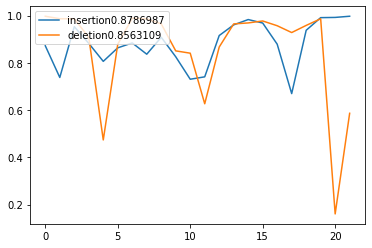

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


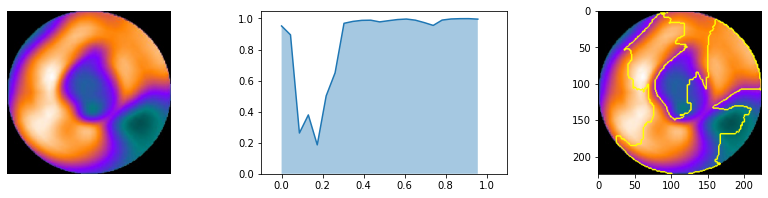

deletion


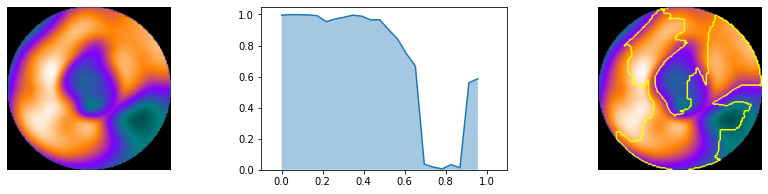

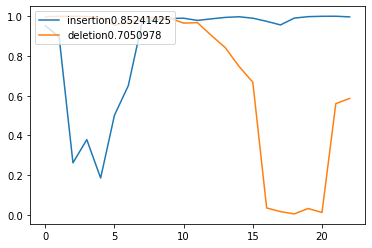

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


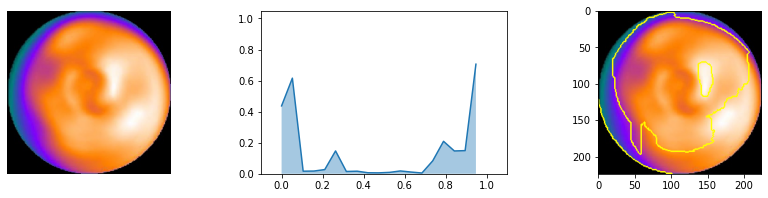

deletion


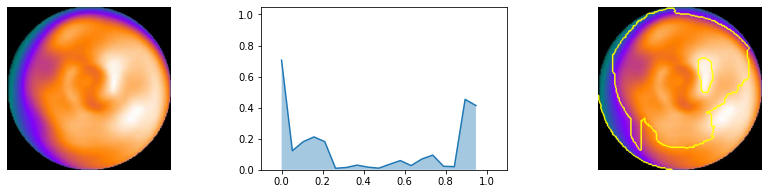

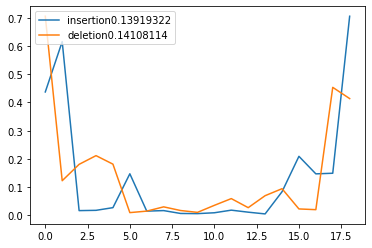

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


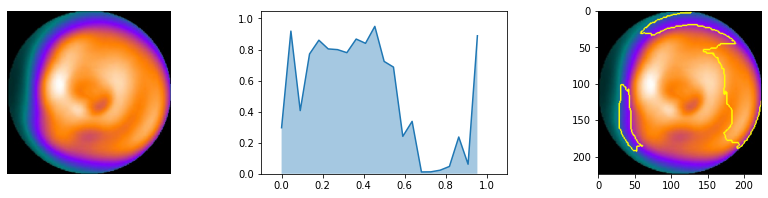

deletion


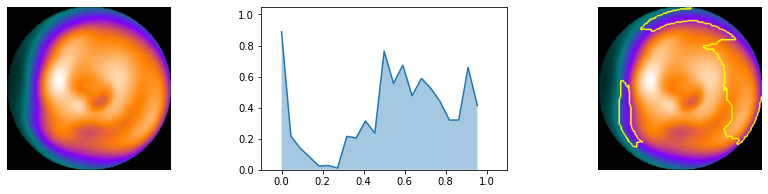

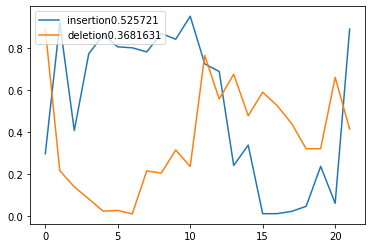

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


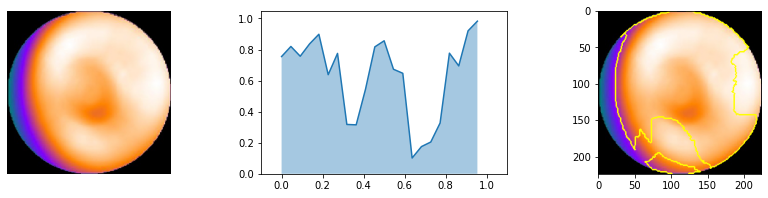

deletion


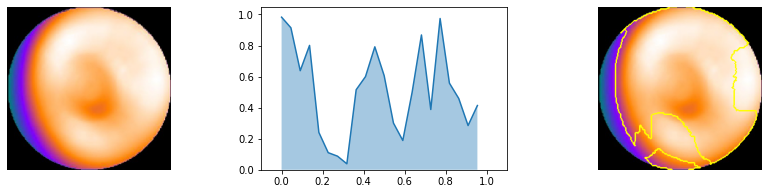

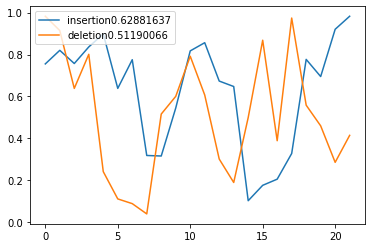

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


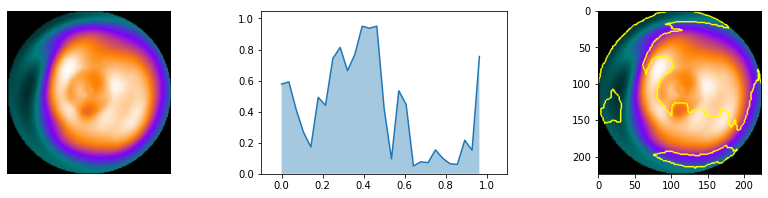

deletion


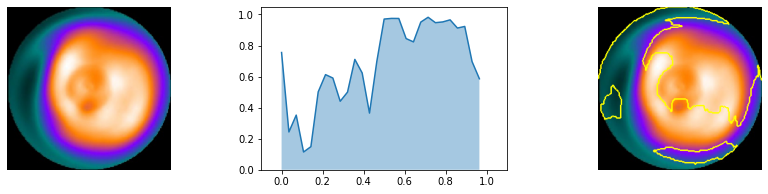

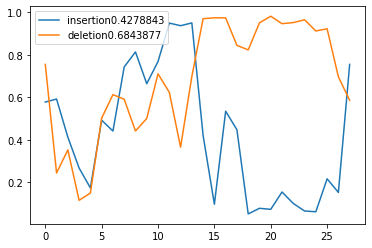

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


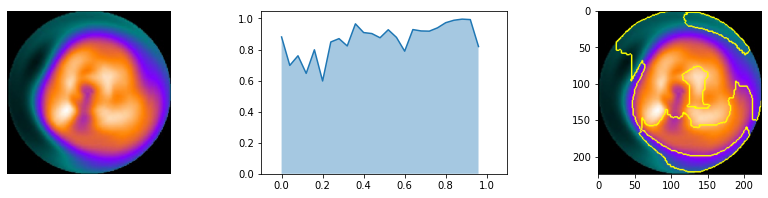

deletion


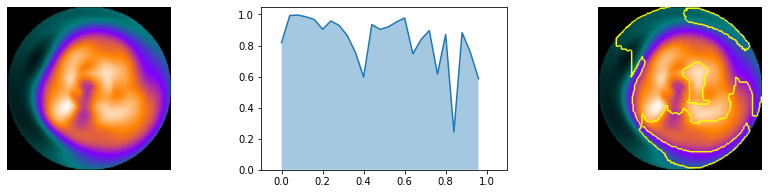

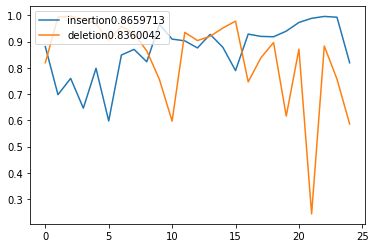

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


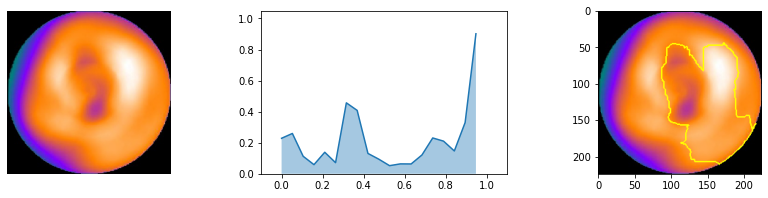

deletion


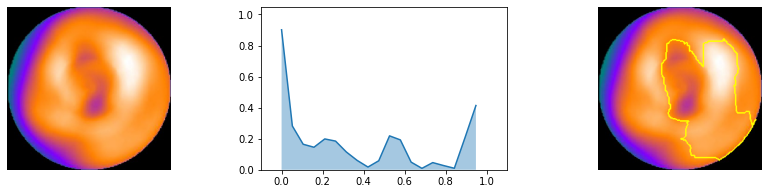

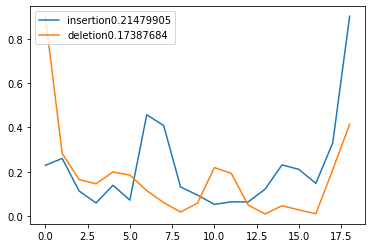

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


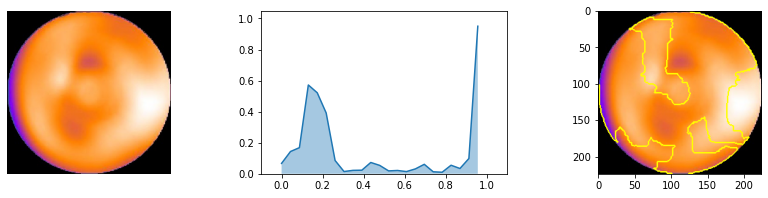

deletion


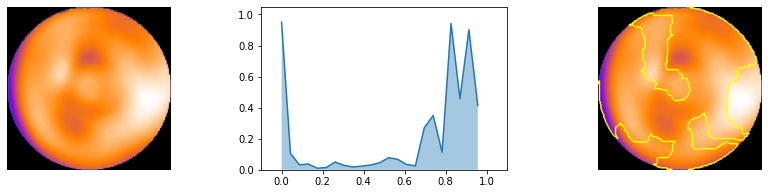

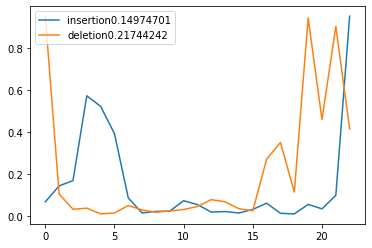

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


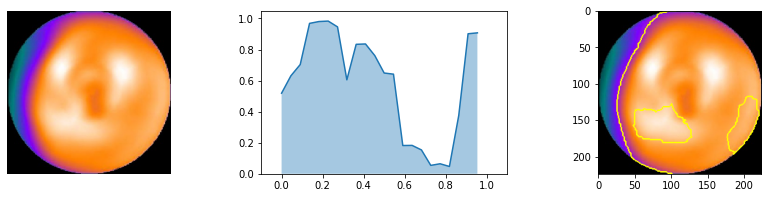

deletion


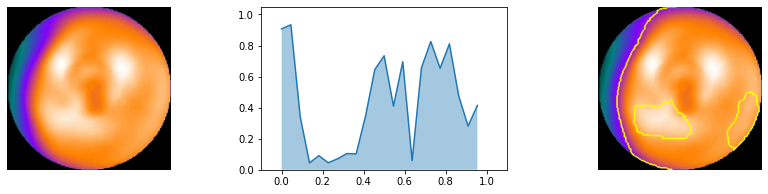

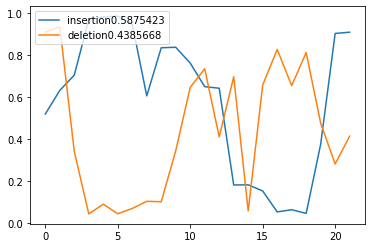

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


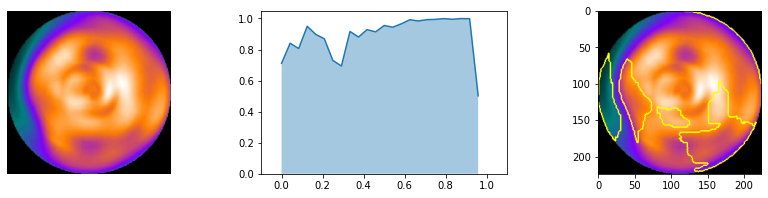

deletion


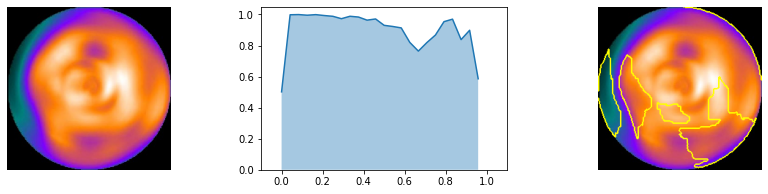

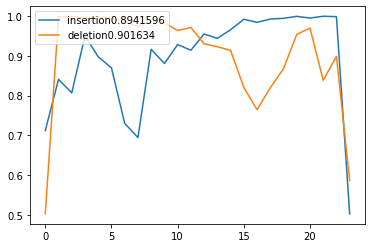

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


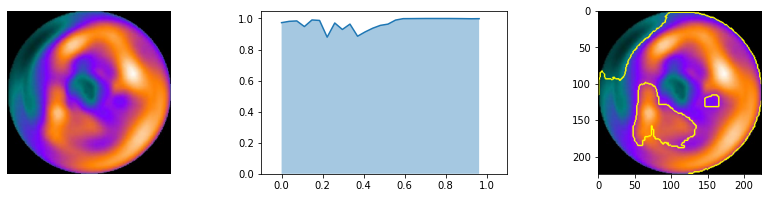

deletion


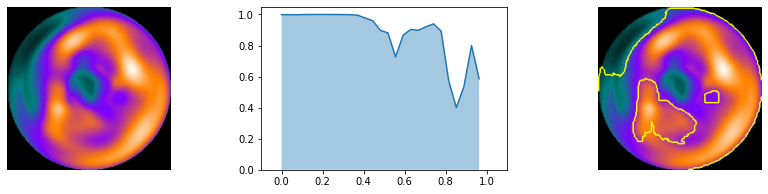

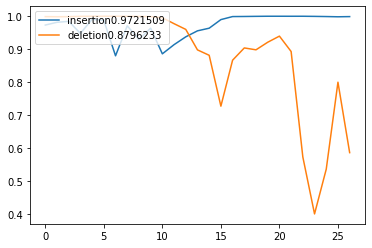

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


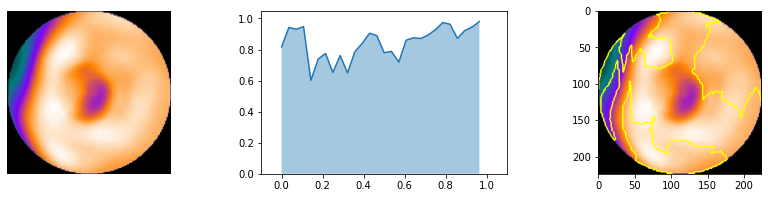

deletion


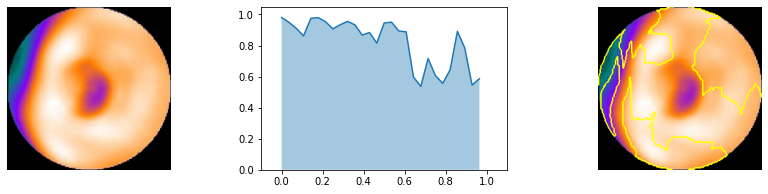

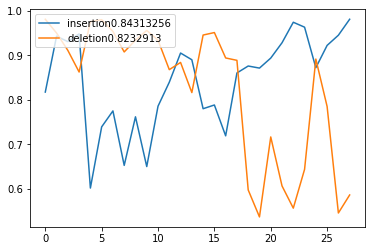

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


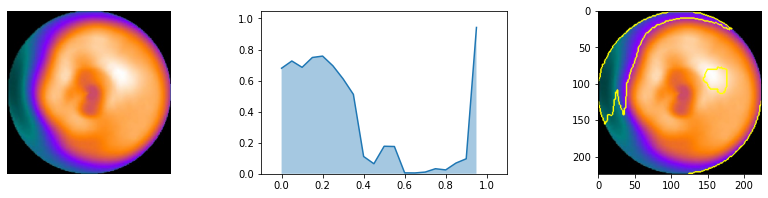

deletion


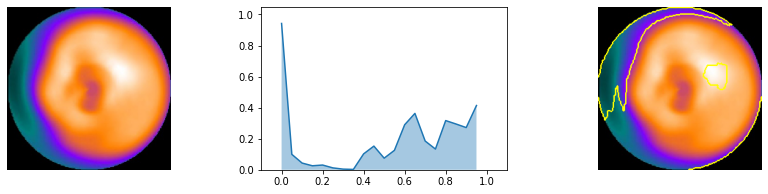

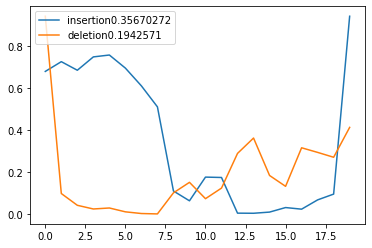

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


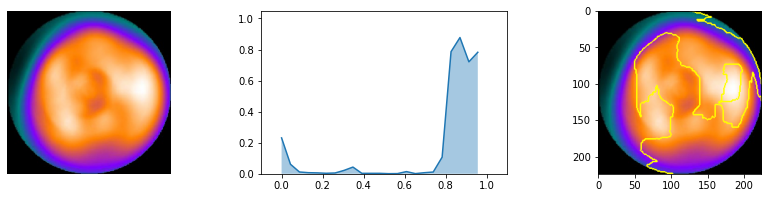

deletion


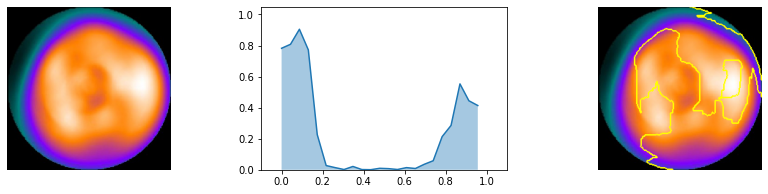

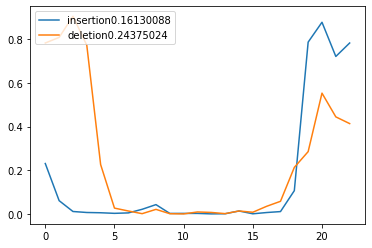

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


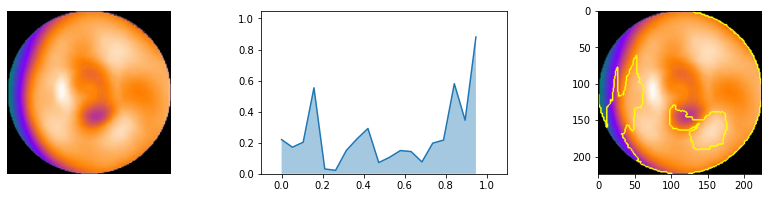

deletion


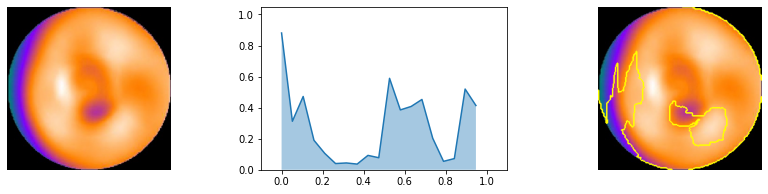

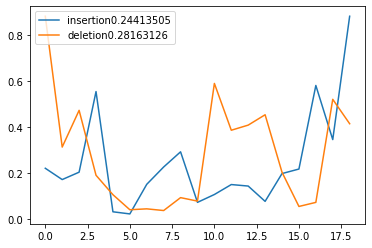

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


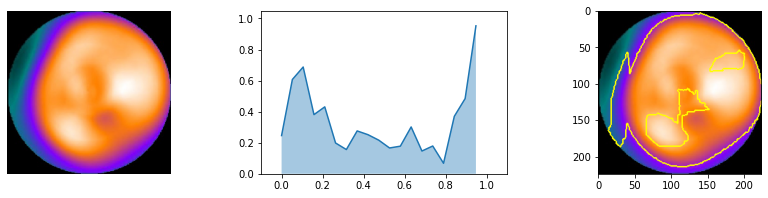

deletion


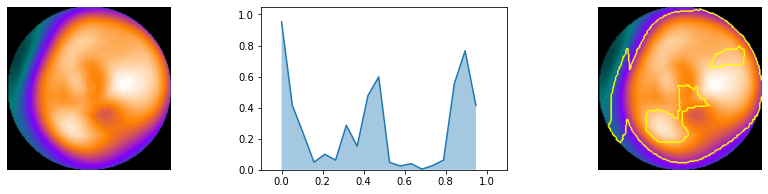

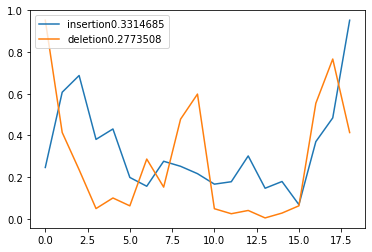

  0%|          | 0/100 [00:00<?, ?it/s]

insertion


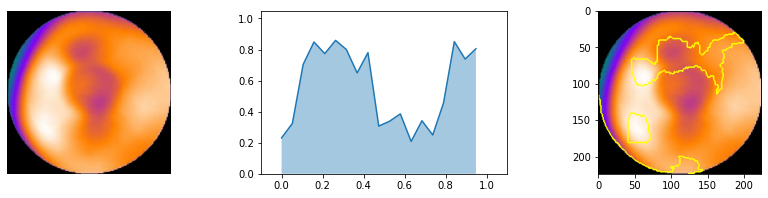

deletion


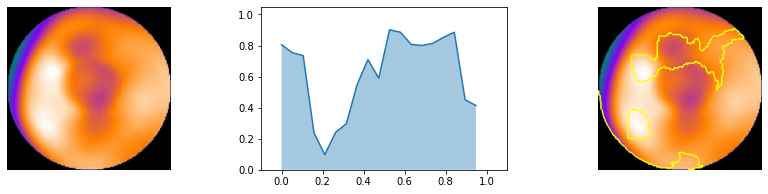

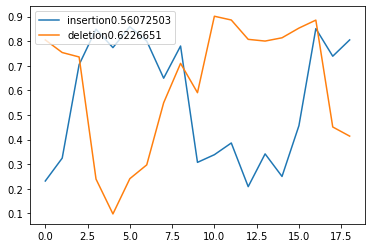

In [ ]:
ins_list,del_list = deletion_insertion()

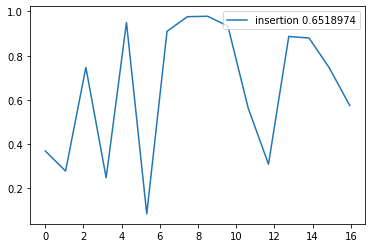

In [ ]:
ins_crop = ins_list[:16]
x = np.arange(0, 17, 17/len(ins_crop))
plt.plot(x,ins_crop,label='insertion '+str(average(ins_crop)))
plt.legend(loc='upper right')
plt.show()

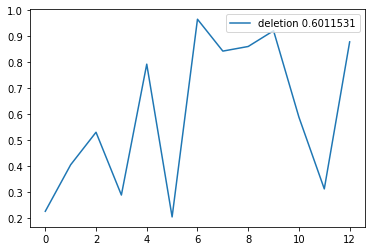

In [ ]:
del_crop = del_list[:13]
x = np.arange(0, 13, 13/len(del_crop))
plt.plot(x,del_crop,label='deletion '+str(average(del_crop)))
plt.legend(loc='upper right')
plt.show()